# Transfer learning workshop

In [101]:
!pip install torchnet

In [102]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import time
import os
import copy
from torchnet import meter # pip install torchnet
import tqdm
import math
import shutil

import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt
import cv2

def show_image(image, figsize=(16, 9), reverse=True):
    plt.figure(figsize=figsize)
    if reverse:
        plt.imshow(image[...,::-1])
    else:
        plt.imshow(image)
    plt.axis('off')
    plt.show()
    
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

# Создадим класс модели

In [103]:
def conv3x3(in_planes, out_planes, stride=1):
    "3x3 convolution with padding"
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,padding=1, bias=False)



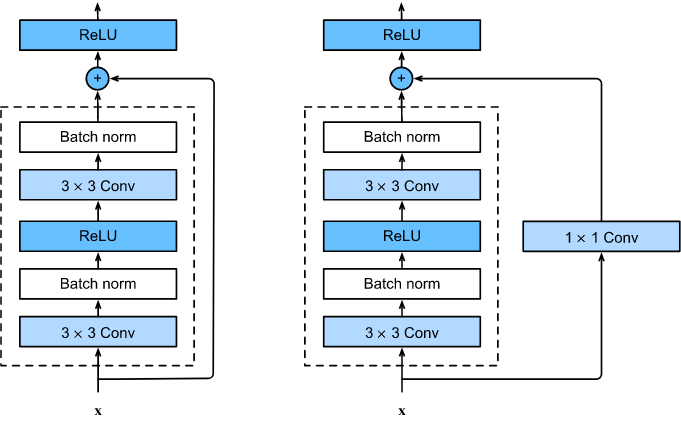

In [104]:
class BasicBlock(nn.Module):
    """
       downsample - to make the dimension of straight and residual tensors the same  
          | ----------------------------------------------------------|
          |                                                           +
        input -> conv -> batch_norm -> relu -> conv -> batch_norm -> out -> relu
    """
    
    expansion = 1

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super(BasicBlock, self).__init__()
        self.conv1 = conv3x3(inplanes, planes, stride)
        self.bn1 = nn.BatchNorm2d(planes)
        self.activation = nn.ReLU()
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):

        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.activation(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            residual = self.downsample(x)

        out += residual
        out = self.activation(out)

        return out

In [4]:
### example of basic block
test_basblock  = BasicBlock(3, 3)
img_ex = torch.rand((4, 3, 32, 32))
test_basblock_out = test_basblock(img_ex)
test_basblock_out.shape

torch.Size([4, 3, 32, 32])

In [5]:
downsample = nn.Sequential(nn.Conv2d(in_channels = 3, out_channels=64, kernel_size=1),
                           nn.BatchNorm2d(64))

test_basblock  = BasicBlock(3, 64, downsample= downsample)

img_ex = torch.rand((4, 3, 32, 32))
test_basblock_out = test_basblock(img_ex)
test_basblock_out.shape

torch.Size([4, 64, 32, 32])

In [105]:
class BasicBlockV3(nn.Module):
     
    
    expansion = 1
    # expansion - how many times the number of output cart activatiosn 
    # is larger from num of inp cart act  
    def __init__(self, inplanes, planes, stride=1, downsample=None):
        """
          downsamples needed for correct dimensions when we plus residual output
          | ------------------------------------------------------------------------|
          |                                                                         +
        input -> batch_norm -> conv -> batch_norm -> relu -> conv -> batch_norm -> out
        """
        super(BasicBlockV3, self).__init__()
        self.bn1 = nn.BatchNorm2d(inplanes)
        self.conv1 = conv3x3(inplanes, planes)
        self.bn2 = nn.BatchNorm2d(planes)
        self.activation = nn.ReLU()
        self.conv2 = conv3x3(planes, planes, stride)
        self.bn3 = nn.BatchNorm2d(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        residual = x

        out = self.bn1(x)
        out = self.conv1(out)
        out = self.bn2(out)
        out = self.activation(out)
        out = self.conv2(out)
        out = self.bn3(out)

        if self.downsample is not None:
            # make the dimension the same as in out
            residual = self.downsample(x)

        out += residual

        return out

In [7]:
### example of basic block

test_basblockV3  = BasicBlockV3(3, 3)
img_ex = torch.rand((4, 3, 32, 32))
test_basblockV3_out = test_basblockV3(img_ex)
test_basblockV3_out.shape

torch.Size([4, 3, 32, 32])

In [8]:
downsample = nn.Sequential(nn.Conv2d(in_channels = 3, out_channels=64, kernel_size=1),
                           nn.BatchNorm2d(64))
test_basblockV3  = BasicBlockV3(3, 64, downsample= downsample)

img_ex = torch.rand((4, 3, 32, 32))
test_basblockV3_out = test_basblockV3(img_ex)
test_basblockV3_out.shape

torch.Size([4, 64, 32, 32])

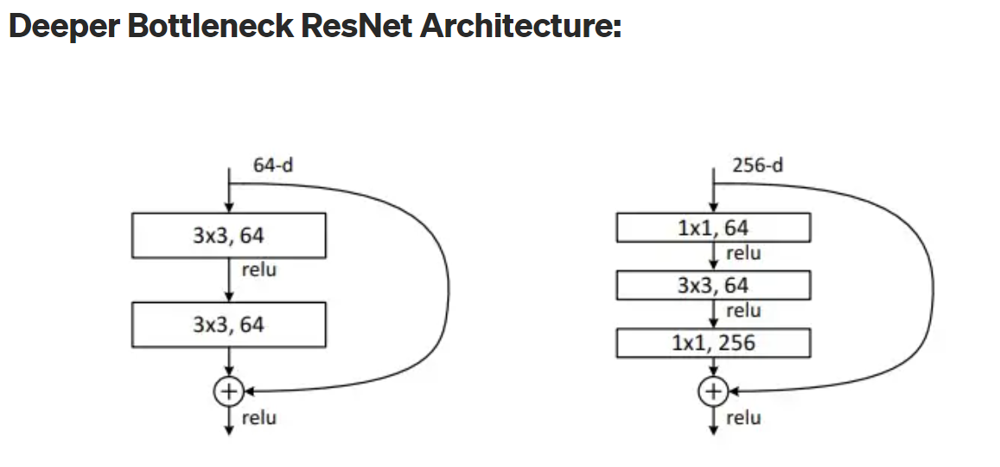

In [106]:
class Bottleneck(nn.Module):
    expansion = 4
     # expansion - how many times the number of output cart activatiosn is larger from num of inp cart act  
    def __init__(self, inplanes, planes, stride=1, downsample=None):
        """
    
        inp--------------------------------------|
         |                                       |
        conv_1X1_inpplane_plane                  |
         |                                       |
        conv_3x3_plane_plane                downsample
         |                                       |
        conv_1x1_plane_plane*expansion           |
         | +  -----------------------------------|                                      
         
        """
        super(Bottleneck, self).__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=stride,
                               padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.conv3 = nn.Conv2d(planes, planes * 4, kernel_size=1, bias=False)
        self.bn3 = nn.BatchNorm2d(planes * 4)
        self.activation = nn.ReLU()
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.activation(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.activation(out)

        out = self.conv3(out)
        out = self.bn3(out)

        if self.downsample is not None:
            # make the dimension the same as in out
            residual = self.downsample(x)

        out += residual
        out = self.activation(out)

        return out

In [11]:
downsample = nn.Sequential(nn.Conv2d(3, 64*4, 1), nn.BatchNorm2d(64*4))
bottleneck_ex  = Bottleneck(3, 64, downsample= downsample)

img_ex = torch.rand((4, 3, 32, 32))
bottleneck_out = bottleneck_ex(img_ex)
bottleneck_out.shape

torch.Size([4, 256, 32, 32])

In [107]:
class HeadE(nn.Module):

    def __init__(self, input_size, emb_size):
        super(HeadE, self).__init__()
        self.fc = nn.Linear(input_size, emb_size)

    def forward(self, inputs):
        """
        inputs -> line_shape -> fully_connect(inp_size, emb_size) -> batch_norm
        """
        inputs = inputs.view(inputs.size(0), -1)
        x = self.fc(inputs)
        x = self.bn2(x)

        return x
    

In [108]:
class ResNetFR(nn.Module):

    def __init__(self, block, layers, emb_size=128, head_size=7*7*512, 
                 preserve_resolution=True, **kwargs):
        
        self.inplanes = 64
        super(ResNetFR, self).__init__()
        if preserve_resolution:
            self.body = nn.Sequential(
                nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(64),
                nn.PReLU())
        else:
            # decrease the size of image in 4 times
            self.body = nn.Sequential(
                nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False),
                nn.BatchNorm2d(64),
                nn.PReLU(),
                nn.MaxPool2d(
                    kernel_size=3,
                    stride=2,
                    padding=1))
            
        self.head_size = head_size
        self.emb_size = emb_size

        self.layer1 = self._make_layer(block,  64, layers[0], stride=2)
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)
        
        # if we want ot recognise sex we have to add arguments: "emb_model"
        if kwargs.get("emb_model", False):
            self.head = HeadE(self.head_size, self.emb_size)
        
        # initialise weights
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def set_parameter_requires_grad(self, layers=set()):
        """Sets parameters from the heads listed in layers to requires_grad=True.
        Args:
            layers: Set  of name strings for heads to set requires_grad=True, e.g. {'pose_model'}.
        """
        if layers:
            for name, param in self.named_parameters():
                if name.split(".")[0] in layers:
                    param.requires_grad = True
                else:
                    param.requires_grad = False

    def set_parameter_to_train(self, layers=set()):
        """Sets parameters from the heads listed in layers to train mode.
        Args:
            layers: Set  of name strings for heads to set to train mode, e.g. {'pose_model'}.
        """
        model.eval()
        for layer in layers:
            head = getattr(self, layer)
            head.train()

    def _make_layer(self, block, planes, blocks_num, stride=1):
        """
        make sequantion of length #blocks using as unit block
        [block, block, block ... block] - blocks_num times
        """
        downsample = None
        # how many out planes from block: planes * expansion
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = list()
        # append first block
        layers.append(block(self.inplanes, planes, stride, downsample))
        
        # from first block the output planes is planes*block.expansion, so
        # the second block the number of input planes is planes*block.expansion
        
        self.inplanes = planes * block.expansion
        # for the remeain blocks the downsample is None, so the 
        # input plane = outplane for all blacks
        for i in range(1, blocks_num):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)

    def forward(self, x):

        device = x.device
        batch_size = x.shape[0]

        x = self.body(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)

        if hasattr(self, 'head'):
            embeddings = self.head(x)
        else:
            embeddings = torch.zeros(batch_size, self.emb_size).detach()

            
        return embeddings

In [109]:
def build_resnet(depth, **kwargs):

    if depth >= 101:
        block = Bottleneck
    else:
        block = BasicBlockV3

    if depth == 18:
        units = [2, 2, 2, 2]
    elif depth == 34:
        units = [3, 4, 6, 3]
    elif depth == 49:
        units = [3, 4, 14, 3]
    elif depth == 50:
        units = [3, 4, 14, 3]
    elif depth == 74:
        units = [3, 6, 24, 3]
    elif depth == 90:
        units = [3, 8, 30, 3]
    elif depth == 100:
        units = [3, 13, 30, 3]
    elif depth == 101:
        units = [3, 4, 23, 3]
    elif depth == 152:
        units = [3, 8, 36, 3]
    else:
        raise ValueError(
            "no experiments done on num_layers {}, you can do it yourself".format(depth))

    model = ResNetFR(block, units, **kwargs)

    return model

# Create model

In [110]:
model_ft = build_resnet(100)

In [111]:
model_ft.head

AttributeError: 'ResNetFR' object has no attribute 'head'

# Create model with emb head

In [112]:
model_ft = build_resnet(100, emb_model=True)

In [113]:
model_ft.head

HeadE(
  (fc): Linear(in_features=25088, out_features=128, bias=True)
)

In [ ]:
#checkpoint = torch.load("fr.pth.tar", map_location='cpu')

In [ ]:
#model_ft.load_state_dict(checkpoint, strict=True)

In [114]:
model_ft

ResNetFR(
  (body): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): PReLU(num_parameters=1)
  )
  (layer1): Sequential(
    (0): BasicBlockV3(
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (activation): ReLU()
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (downsample): Sequential(
        (0): Conv2d(64, 64, kernel_size=(1, 1), stride=(2, 2), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
   

# Добавим голову для предсказания пола

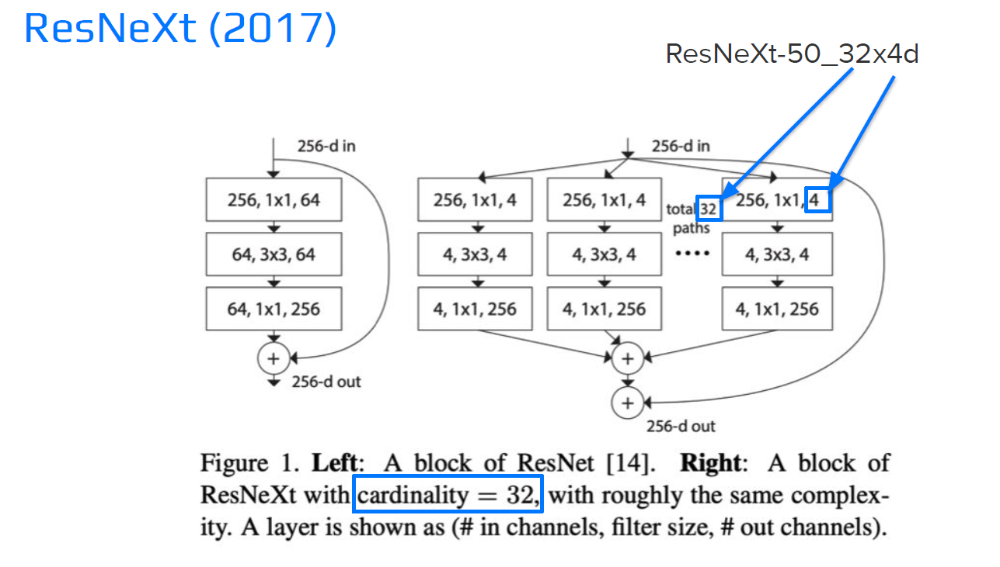

### ResNeXtBottleneck

In [115]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.utils import weight_norm
from torch.nn import init

In [116]:
### example of forward  ResNeXtBottleneck

in_channels = 3
out_channels = 16
stride = 1
cardinality = 5
widen_factor = 1
D = cardinality * out_channels // widen_factor 
print(f"cardinality={cardinality}, D={D}")

cardinality=5, D=80


In [117]:
inp = torch.rand((16, 3, 64, 64))
print(f"input shape: {inp.shape}")
# 1) this layer change the numbe of filters from in_channes to D
conv_reduce = nn.Conv2d(in_channels, D, kernel_size=1, stride=1, padding=0, bias=False)
conv_reduce_out = conv_reduce(inp)
print(f"conv_reduce_output shape: {conv_reduce_out.shape}") 
print(f"conv_reduce kernel shape is: {conv_reduce.weight.data.shape}")

input shape: torch.Size([16, 3, 64, 64])
conv_reduce_output shape: torch.Size([16, 80, 64, 64])
conv_reduce kernel shape is: torch.Size([80, 3, 1, 1])


In [118]:
# 2) the dimensions isn't change
bn_reduce = nn.BatchNorm2d(D)
bn_reduce_out = F.relu(bn_reduce.forward(conv_reduce_out), inplace=True)
bn_reduce_out.shape

torch.Size([16, 80, 64, 64])

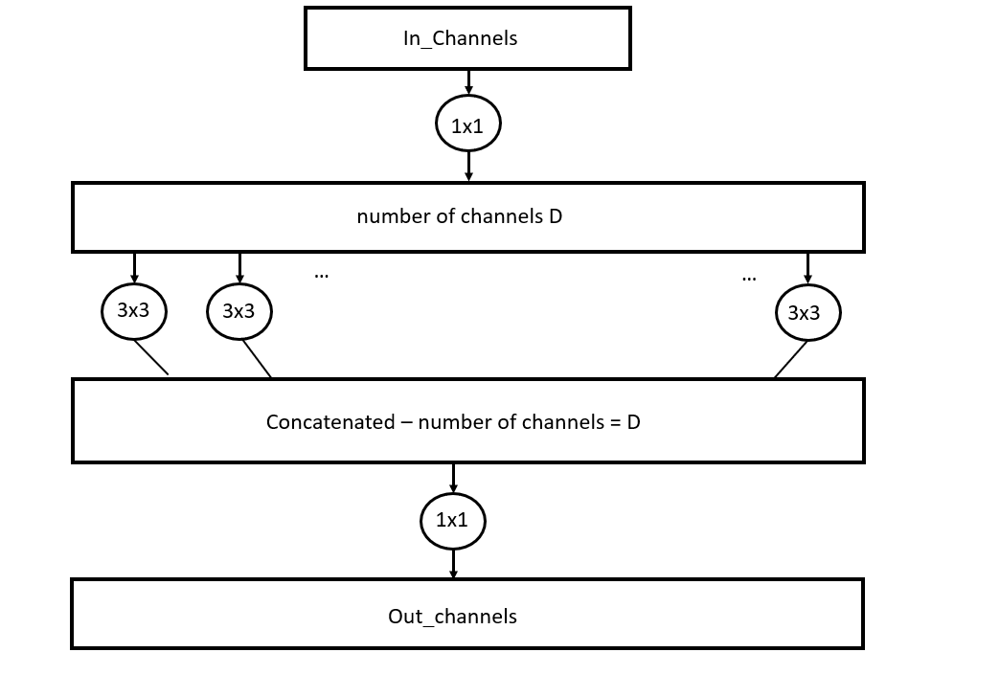

In [26]:
# 3) Using cardinality -> paralel path
conv_conv = nn.Conv2d(D, D, kernel_size=3, stride=stride, padding=1, groups=cardinality, bias=False)
conv_conv_out = conv_conv(bn_reduce_out)
print(f"conv_conv data shape: {conv_conv.weight.data.shape}")
print(f"input shape: {bn_reduce_out.shape}")
print(f"output shape: {conv_conv_out.shape}")

conv_conv data shape: torch.Size([80, 16, 3, 3])
input shape: torch.Size([16, 80, 64, 64])
output shape: torch.Size([16, 80, 64, 64])


In [ ]:
### example of forward  ResidualTailNetwork

in_channels = 256
out_channels = 256
stride = 1
cardinality = 16
widen_factor = 4
D = cardinality * out_channels // widen_factor
stages = [64 * widen_factor, 128 * widen_factor, 256 * widen_factor]
depths = [3, 4]
block_depth = 3

inp = torch.rand((16, 256, 224, 224))
print(f"{cardinality}, {D}")

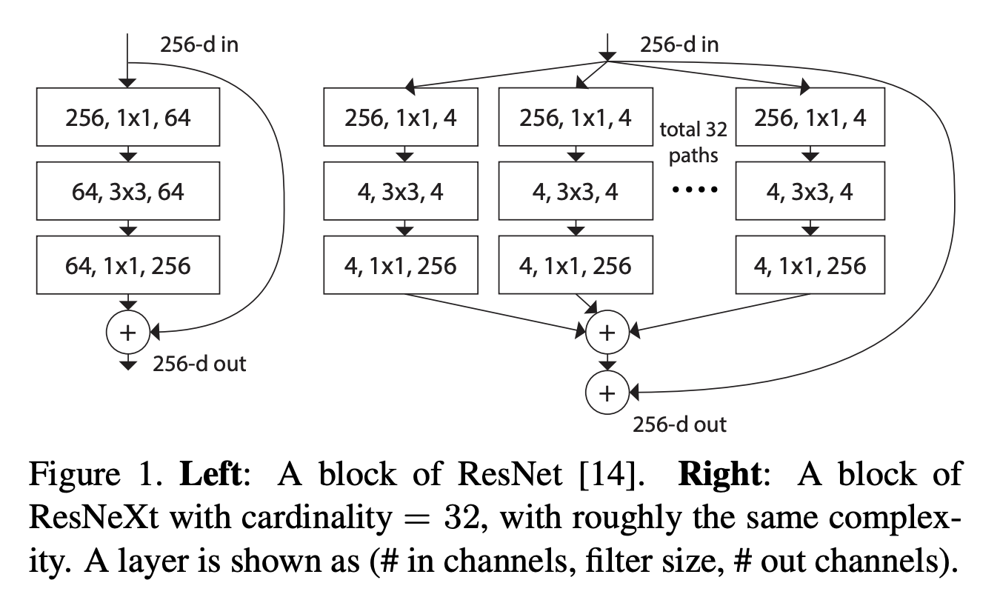

In [119]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn.utils import weight_norm
from torch.nn import init


class ResNeXtBottleneck(nn.Module):
    """
    RexNeXt bottleneck type C (https://github.com/facebookresearch/ResNeXt/blob/master/models/resnext.lua)
    
    | ----------------------------------------------------------------------------------|
    |                                                                                   +
    inp -> conv(in, D) -> BN_R -> conv(D, D, cardinality) -> BN_R -> conv(D, out) -> BN -> out
    1) change the number of channels from in channels to D, 1X1 convlayer  + BN + relu,
    2) seperate convolutional layer, cardinality number of groups, takes D/cardinality 
       input channels, and  produce D/cardinality channels which be concatenated -> D channels
       + BN + ReLU
    3) expand D filters to output filters + BN
    4) residual connections - change channels from input to output + BN
    5) + residual connections, BN, relu
    
    """
    def __init__(self, in_channels, out_channels, stride, cardinality, widen_factor):
        """ Constructor
        Args:
            in_channels: input channel dimensionality
            out_channels: output channel dimensionality
            stride: conv stride. Replaces pooling layer.
            cardinality: num of convolution groups.
            widen_factor: factor to reduce the input dimensionality before convolution.
                 
        """
        super(ResNeXtBottleneck, self).__init__()
        D = cardinality * out_channels // widen_factor
        # layer to change the number of channels from in_channels to D
        self.conv_reduce = nn.Conv2d(in_channels, D, kernel_size=1, stride=1, padding=0, bias=False)
        self.bn_reduce = nn.BatchNorm2d(D)
        
        # layer with paralel computations with number of path equal cardinality
        self.conv_conv = nn.Conv2d(D, D, kernel_size=3, stride=stride, 
                                   padding=1, groups=cardinality, bias=False)
        self.bn = nn.BatchNorm2d(D)
        
        # change the number of channels from D to out_channels
        self.conv_expand = nn.Conv2d(D, out_channels, kernel_size=1, stride=1, padding=0, bias=False)
        self.bn_expand = nn.BatchNorm2d(out_channels)
        
        # for the residual connections
        self.shortcut = nn.Sequential()
        if in_channels != out_channels:
            self.shortcut.add_module('shortcut_conv', nn.Conv2d(in_channels, out_channels,
                                                                kernel_size=1, stride=stride, padding=0, bias=False))
            self.shortcut.add_module('shortcut_bn', nn.BatchNorm2d(out_channels))

    def forward(self, x):
        #  change the number of in_channels
        bottleneck = self.conv_reduce.forward(x)
        # batchnorm + relu
        bottleneck = F.relu(self.bn_reduce.forward(bottleneck), inplace=True)
        # paralel path layer
        bottleneck = self.conv_conv.forward(bottleneck)
        bottleneck = F.relu(self.bn.forward(bottleneck), inplace=True)
        bottleneck = self.conv_expand.forward(bottleneck)
        bottleneck = self.bn_expand.forward(bottleneck)
        # add residual path
        residual =   self.shortcut.forward(x)
        return F.relu(residual + bottleneck, inplace=True)



In [120]:
class ResidualTailNetwork(nn.Module):
    def __init__(self, n_classes=1, widen_factor=4):
        super(ResidualTailNetwork, self).__init__()
        self.relu = nn.ReLU(inplace=True)
        self.block_depth = 3
        self.cardinality = 16
        self.widen_factor = widen_factor
        self.n_classes = n_classes

        self.stages = [64 * self.widen_factor, 128 * self.widen_factor, 256 * self.widen_factor]
        # self.depths = [2, 3, 4]
        self.depths = [3, 4]
                                 # name,     in_channels,    out_channels, stride
        self.stage_1 = self.block('stage_1', self.stages[0], self.stages[1],    2)
        self.stage_2 = self.block('stage_2', self.stages[1], self.stages[2],    2)

        for key in self.state_dict():
            if key.split('.')[-1] == 'weight':
                if 'conv' in key:
                    init.kaiming_normal_(self.state_dict()[key], mode='fan_out')
                if 'bn' in key:
                    self.state_dict()[key][...] = 1
            elif key.split('.')[-1] == 'bias':
                self.state_dict()[key][...] = 0

        self.avgpool = nn.AvgPool2d(4)
        self.fc = nn.Linear(self.stages[-1], self.n_classes)
        if self.widen_factor == 1:
            self.fc = nn.Linear(self.stages[-1] * 4, self.n_classes) 

    def block(self, name, in_channels, out_channels, pool_stride=2):
        """ Stack n bottleneck modules where n is inferred from the depth of the network.
        Args:
            name: string name of the current block.
            in_channels: number of input channels
            out_channels: number of output channels
            pool_stride: factor to reduce the spatial dimensionality in the first bottleneck of the block.
        Returns: a Module consisting of n sequential bottlenecks.
        """
        block = nn.Sequential()
        for bottleneck in range(self.block_depth):
            name_ = '%s_bottleneck_%d' % (name, bottleneck)
            if bottleneck == 0:
                block.add_module(name_, ResNeXtBottleneck(in_channels, out_channels, pool_stride, 
                                                          self.cardinality, self.widen_factor))
            else:
                block.add_module(name_, ResNeXtBottleneck(out_channels, out_channels, 1, 
                                                          self.cardinality, self.widen_factor))

        return block

    def forward(self, x):
        x = self.stage_1.forward(x)
        x = self.stage_2.forward(x)
        x = self.avgpool(x)
        x = x.view(x.size(0), -1)
        x = self.fc(x)
        return x

# Добавьте новую голову self.gender_model, обновите код forward-пасса

In [121]:
class ResNetFR(nn.Module):

    def __init__(self, block, layers, emb_size=128, head_size=7*7*512, preserve_resolution=True, **kwargs):
        self.inplanes = 64
        super(ResNetFR, self).__init__()
        if preserve_resolution:
            self.body = nn.Sequential(
                nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False),
                nn.BatchNorm2d(64),
                nn.PReLU())
        else:
            self.body = nn.Sequential(
                nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False),
                nn.BatchNorm2d(64),
                nn.PReLU(),
                nn.MaxPool2d(
                    kernel_size=3,
                    stride=2,
                    padding=1))
            
        self.head_size = head_size
        self.emb_size = emb_size
        self.gender_only = kwargs.get("gender_only", False)

        self.layer1 = self._make_layer(block, 64, layers[0], stride=2)
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)
        
        if kwargs.get("emb_model", False):
            self.head = HeadE(self.head_size, self.emb_size)

        # cоздайте голову для предсказания одного числа - вероятности одного из полов. hint: resnext block, 
        # widen_factor=4
        # < ваш код здесь > 
        if kwargs.get("gender_model", True):
            self.gender_model = ResidualTailNetwork(n_classes=1, widen_factor=4)
        
        
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                n = m.kernel_size[0] * m.kernel_size[1] * m.out_channels
                m.weight.data.normal_(0, math.sqrt(2. / n))
            elif isinstance(m, nn.BatchNorm2d):
                m.weight.data.fill_(1)
                m.bias.data.zero_()

    def set_parameter_requires_grad(self, layers=set()):
        """Sets parameters from the heads listed in layers to requires_grad=True.
        Args:
            layers: Set  of name strings for heads to set requires_grad=True, e.g. {'pose_model'}.
        """
        if layers:
            for name, param in self.named_parameters():
                if name.split(".")[0] in layers:
                    param.requires_grad = True
                else:
                    param.requires_grad = False

    def set_parameter_to_train(self, layers=set()):
        """Sets parameters from the heads listed in layers to train mode.
        Args:
            layers: Set  of name strings for heads to set to train mode, e.g. {'pose_model'}.
        """
        model.eval()
        for layer in layers:
            head = getattr(self, layer)
            head.train()

    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None
        if stride != 1 or self.inplanes != planes * block.expansion:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes * block.expansion,
                          kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(planes * block.expansion),
            )

        layers = list()
        layers.append(block(self.inplanes, planes, stride, downsample))
        self.inplanes = planes * block.expansion
        
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)

    def forward(self, x):

        device = x.device
        batch_size = x.shape[0]

        x = self.body(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        
        # добавьте предсказание пола
        # < ваш код здесь > 
        if hasattr(self, "gender_model"):
            male_proba = self.gender_model(x)
        else:
            male_proba = torch.zeros(batch_size, 1)
        
        if self.gender_only:
            return male_proba

        x = self.layer4(x)

        if hasattr(self, 'head'):
            embeddings = self.head(x)
        else:
            embeddings = torch.zeros(batch_size, self.emb_size).detach()

        return embeddings, male_proba

# Create model without emb head

In [156]:
model_ft = build_resnet(100, emb_model=False, gender_model=True, gender_only=True)

In [157]:
model_ft.gender_model

ResidualTailNetwork(
  (relu): ReLU(inplace=True)
  (stage_1): Sequential(
    (stage_1_bottleneck_0): ResNeXtBottleneck(
      (conv_reduce): Conv2d(256, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn_reduce): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv_conv): Conv2d(2048, 2048, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=16, bias=False)
      (bn): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv_expand): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn_expand): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (shortcut): Sequential(
        (shortcut_conv): Conv2d(256, 512, kernel_size=(1, 1), stride=(2, 2), bias=False)
        (shortcut_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (stage_1_bottleneck_1): ResNeXtBottleneck(
      (conv_red

In [ ]:
# checkpoint = ...

In [ ]:
# загрузите предобученные веса модели
#< ваш код здесь>

# Модель работает с тензорами размера 3х112х112. Убедитесь, что она возвращает то, что нам нужно

In [124]:
model_ft.eval()

ResNetFR(
  (body): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): PReLU(num_parameters=1)
  )
  (layer1): Sequential(
    (0): BasicBlockV3(
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (activation): ReLU()
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (downsample): Sequential(
        (0): Conv2d(64, 64, kernel_size=(1, 1), stride=(2, 2), bias=False)
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
   

In [160]:
with torch.no_grad():
    print(model_ft(torch.rand((1, 3, 112, 112)).data))

tensor([[-0.4578]])


# Useful functions

In [162]:
class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count
        
        
def save_checkpoint(state, is_best_gender=False,  filename='checkpoint'):
    torch.save(state, filename + '.pth.tar')
    if is_best_gender:
        shutil.copyfile(filename + '.pth.tar', filename + '_best_gender.pth.tar')
        
        
def imshow(inp, title=None, figsize=(16, 9)):
    """Imshow for Tensor."""
    plt.figure(figsize=figsize)
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated
    
    
def set_bn_eval(module):
    if isinstance(module, torch.nn.modules.batchnorm._BatchNorm):
        module.eval()
          
def set_parameter_requires_grad(model, layers=set()):
    """Sets parameters from the heads listed in layers to requires_grad=True.
    Args:
        layers: Set  of name strings for heads to set requires_grad=True, e.g. {'pose_model'}.
    """
    model.eval()
    if layers:
        for name, param in model.named_parameters():
            if name.split(".")[0] in layers:
                param.requires_grad = True
            else:
                param.requires_grad = False

                
def set_parameter_to_train(model, layers=set()):
    """Sets parameters from the heads listed in layers to train mode.
    Args:
        layers: Set  of name strings for heads to set to train mode, e.g. {'pose_model'}.
    """
    model.eval()
    for layer in layers:
        head = getattr(model, layer)
        head.train()
        enable_running_stats(head)

        
def disable_running_stats(model):
    for module in model.modules():
        if hasattr(module, 'track_running_stats'):
            module.track_running_stats = False
        
        
def enable_running_stats(model):
    for module in model.modules():
        if hasattr(module, 'track_running_stats'):
            module.track_running_stats = True

    
def get_trainable_params(model):
    if hasattr(model, 'module'):
        parameters = model.module.named_parameters()
    else:
        parameters = model.named_parameters()
    
    print ("Parameters to update:")
    params_to_update = []
    for name, param in parameters:
        if param.requires_grad == True:
            params_to_update.append(param)
            print("\t",name)
    return params_to_update

# Определим аугментации и загрузим датасеты

In [163]:
train_transforms = transforms.Compose([
        transforms.Resize((112, 112)),
        transforms.RandomHorizontalFlip(),
        transforms.ColorJitter(
            brightness=0.4,
            contrast=0.4,
            saturation=0.4),
        transforms.RandomGrayscale(p=0.1),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])


val_transforms = transforms.Compose([
        transforms.Resize((112, 112)),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])

In [141]:
train_folder = '/kaggle/input/gender-recognition-200k-images-celeba/Dataset/Train'
val_folder = '/kaggle/input/gender-recognition-200k-images-celeba/Dataset/Validation'

In [142]:
train_dataset = torchvision.datasets.ImageFolder(train_folder, train_transforms)
len(train_dataset)

160000

In [143]:
val_dataset = torchvision.datasets.ImageFolder(val_folder, val_transforms)
len(val_dataset)

22598

In [144]:
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=2)
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=2)

# Посмотрим глазами на выборку

In [139]:
test_image = inputs[0]
test_image.shape

transforms.Resize((112,112))(test_image).shape

torch.Size([3, 112, 112])

In [145]:
inputs, classes = next(iter(val_dataloader))
inputs.shape

torch.Size([64, 3, 112, 112])

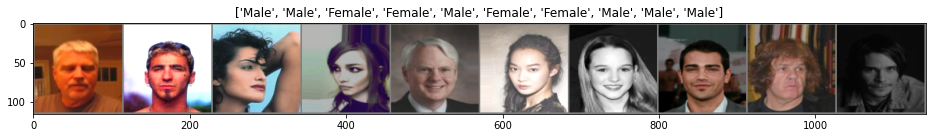

In [164]:
class_names = train_dataset.classes

# Get a batch of training data
inputs, classes = next(iter(train_dataloader))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs[:10], nrow=10)
imshow(out, title=[class_names[x] for x in classes[:10]])

# Train / Val functions

In [183]:
train_dataset.class_to_idx

{'Female': 0, 'Male': 1}

In [196]:
for i, (input_tensor, gender_labels) in enumerate(tqdm.tqdm(train_dataloader)):
    input_tensor = input_tensor.to(device)
    gender_labels = gender_labels.float().to(device)
    with torch.no_grad():    
    # compute output
        gender_preds = model_ft(input_tensor).squeeze(1)
    break

  0%|          | 0/2500 [00:00<?, ?it/s]


In [197]:
gender_labels

tensor([0., 0., 1., 1., 0., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1., 1., 0., 0.,
        1., 0., 0., 0., 1., 1., 0., 1., 0., 1., 1., 1., 0., 0., 1., 1., 1., 0.,
        1., 0., 0., 0., 1., 1., 0., 0., 0., 0., 1., 0., 1., 0., 0., 0., 1., 0.,
        0., 1., 1., 1., 0., 0., 0., 0., 1., 0.], device='cuda:0')

In [206]:
print((torch.round(torch.sigmoid(gender_preds)) == gender_labels).sum()/gender_labels.shape[0])

tensor(0.9688, device='cuda:0')


In [165]:
def train(train_loader, model, criterion, optimizer, epoch, trainable_params=['gender_model'], device='cuda', print_freq=10):
    
    # with NLL loss
    batch_time = AverageMeter()
    data_time = AverageMeter()
    avg_loss = AverageMeter()
    
    # switch to train mode
    model.train()
    model.to(device)
    
    # set only gender head to train
    set_parameter_requires_grad(model, set(trainable_params))
    set_parameter_to_train(model_ft, set(trainable_params))

        
    #set meters
    gender_auc_mtr = meter.AUCMeter()
        
    end = time.time()
    for i, (input_tensor, gender_labels) in enumerate(tqdm.tqdm(train_loader)):
        
        # measure data loading time
        data_time.update(time.time() - end)
        
        input_tensor = input_tensor.to(device)
        gender_labels = gender_labels.float().to(device)
        
        # compute output
        gender_preds = model(input_tensor).squeeze(1)
        
        # gender + age
        gender_loss = criterion(gender_preds, gender_labels)

        avg_loss.update(gender_loss.item(), input_tensor.shape[0])

        # compute gradient and do optimizer step
        optimizer.zero_grad()
        gender_loss.backward()
        optimizer.step()

        # measure elapsed time
        batch_time.update(time.time() - end)
        end = time.time()
        
        # update gender stats
        gender_auc_mtr.add(torch.sigmoid(gender_preds.detach()), gender_labels)
                        
            
    train_gender_roc_auc, _, _= gender_auc_mtr.value()
    
    return train_gender_roc_auc, avg_loss

In [166]:
def validate(model, val_dataloader, gender_thresh=0.5, device='cuda'):
    gender_auc_mtr = meter.AUCMeter()
    gender_confusion_mtr = meter.ConfusionMeter(k=2)
    
    model.eval().to(device)
    running_loss = 0.0
    # будем записывать сюда имена файлов, на которых мы ошиблись
    gender_mistakes = []
    male_index = val_dataloader.dataset.class_to_idx['Male']
    
    for inputs, genders in tqdm.tqdm(val_dataloader):
        inputs = inputs.to(device)
        gender_labels = genders.float().to(device)

        with torch.no_grad():
            gender_preds = model(inputs)
        
        gender_preds = torch.sigmoid(gender_preds)
        gender_preds_labels = gender_preds > gender_thresh
        
        gender_mistakes.extend(list(map(int, gender_preds_labels.flatten().long() != 
                                                            gender_labels.flatten().long())))

        # update gender stats
        gender_auc_mtr.add(gender_preds, gender_labels)

        gender_confusion_mtr.add(torch.nn.functional.one_hot(gender_preds_labels.flatten().long(), num_classes=2), 
                                 torch.nn.functional.one_hot(gender_labels.flatten().long(), num_classes=2))
        
    
    val_gender_roc_auc, _, _= gender_auc_mtr.value()
    val_gender_confusion_matrix = gender_confusion_mtr.value()
    val_gender_acc = np.trace(val_gender_confusion_matrix) / np.sum(val_gender_confusion_matrix)
    return val_gender_roc_auc, val_gender_acc, val_gender_confusion_matrix, gender_mistakes

# Заморозим всё, кроме головы

In [167]:
# disable_running_stats(model_ft)
# set_parameter_requires_grad(model_ft, ['gender_model'])
# set_parameter_to_train(model_ft, ['gender_model'])
trainable_parameters = get_trainable_params(model_ft)

Parameters to update:
	 body.0.weight
	 body.1.weight
	 body.1.bias
	 body.2.weight
	 layer1.0.bn1.weight
	 layer1.0.bn1.bias
	 layer1.0.conv1.weight
	 layer1.0.bn2.weight
	 layer1.0.bn2.bias
	 layer1.0.conv2.weight
	 layer1.0.bn3.weight
	 layer1.0.bn3.bias
	 layer1.0.downsample.0.weight
	 layer1.0.downsample.1.weight
	 layer1.0.downsample.1.bias
	 layer1.1.bn1.weight
	 layer1.1.bn1.bias
	 layer1.1.conv1.weight
	 layer1.1.bn2.weight
	 layer1.1.bn2.bias
	 layer1.1.conv2.weight
	 layer1.1.bn3.weight
	 layer1.1.bn3.bias
	 layer1.2.bn1.weight
	 layer1.2.bn1.bias
	 layer1.2.conv1.weight
	 layer1.2.bn2.weight
	 layer1.2.bn2.bias
	 layer1.2.conv2.weight
	 layer1.2.bn3.weight
	 layer1.2.bn3.bias
	 layer2.0.bn1.weight
	 layer2.0.bn1.bias
	 layer2.0.conv1.weight
	 layer2.0.bn2.weight
	 layer2.0.bn2.bias
	 layer2.0.conv2.weight
	 layer2.0.bn3.weight
	 layer2.0.bn3.bias
	 layer2.0.downsample.0.weight
	 layer2.0.downsample.1.weight
	 layer2.0.downsample.1.bias
	 layer2.1.bn1.weight
	 layer2.1.bn1.b

In [168]:
#odel_ft.cuda()

criterion = nn.BCEWithLogitsLoss()

# Observe that only part of the parameters are being optimized
optimizer_ft = optim.SGD(trainable_parameters, lr=0.001, momentum=0.9)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)

In [169]:
val_dataloader.dataset.class_to_idx

{'Female': 0, 'Male': 1}

In [173]:
best_gender_roc_auc = 0.0

for epoch in range(50):
    train_gender_roc_auc, avg_loss  = train(train_dataloader, model_ft, criterion, optimizer_ft, 
                                                                    epoch, trainable_params=['gender_model'])
    print('Train gender roc-auc %1.5f' % train_gender_roc_auc)
    
    val_gender_roc_auc, val_gender_acc, val_gender_confusion_matrix, gender_mistakes = validate(model_ft, val_dataloader)
    exp_lr_scheduler.step()
    
    is_best_gender = False
    if val_gender_roc_auc > best_gender_roc_auc:
        print ("Best gender model")
        is_best_gender = True
        best_gender_roc_auc = val_gender_roc_auc
    
    
    print('Val gender roc-auc %1.5f, \
          Val gender accuracy %1.5f, \
          Best gender roc-auc %1.5f'
          % (val_gender_roc_auc, val_gender_acc, best_gender_roc_auc))
    
    # save mistakes
    mistakes_filenames = np.array(val_dataset.samples)[np.argwhere(gender_mistakes).flatten()]
    
    save_checkpoint({
    'epoch': epoch + 1,
    'state_dict': model_ft.state_dict(),
    'train_gender_roc_auc': train_gender_roc_auc,
    'val_gender_roc_auc': val_gender_roc_auc,
    'val_gender_accuracy': val_gender_acc,
    'optimizer' : optimizer_ft.state_dict(),
    'gender_mistakes_filenames': mistakes_filenames,
    }, is_best_gender, 'resnet100_workshop')

100%|██████████| 2500/2500 [12:34<00:00,  3.31it/s]


Train gender roc-auc 0.91763


100%|██████████| 354/354 [01:14<00:00,  4.74it/s]


Best gender model
Val gender roc-auc 0.96365,           Val gender accuracy 0.90092,           Best gender roc-auc 0.96365


100%|██████████| 2500/2500 [12:30<00:00,  3.33it/s]


Train gender roc-auc 0.95347


100%|██████████| 354/354 [01:01<00:00,  5.76it/s]


Best gender model
Val gender roc-auc 0.96883,           Val gender accuracy 0.89411,           Best gender roc-auc 0.96883


100%|██████████| 2500/2500 [12:30<00:00,  3.33it/s]


Train gender roc-auc 0.96156


100%|██████████| 354/354 [01:01<00:00,  5.80it/s]


Best gender model
Val gender roc-auc 0.97240,           Val gender accuracy 0.89645,           Best gender roc-auc 0.97240


100%|██████████| 2500/2500 [12:33<00:00,  3.32it/s]


Train gender roc-auc 0.96559


100%|██████████| 354/354 [01:05<00:00,  5.38it/s]


Best gender model
Val gender roc-auc 0.97371,           Val gender accuracy 0.90296,           Best gender roc-auc 0.97371


100%|██████████| 2500/2500 [12:30<00:00,  3.33it/s]


Train gender roc-auc 0.96876


100%|██████████| 354/354 [01:00<00:00,  5.85it/s]


Best gender model
Val gender roc-auc 0.97558,           Val gender accuracy 0.89840,           Best gender roc-auc 0.97558


100%|██████████| 2500/2500 [12:29<00:00,  3.34it/s]


Train gender roc-auc 0.97123


100%|██████████| 354/354 [01:00<00:00,  5.84it/s]


Best gender model
Val gender roc-auc 0.97580,           Val gender accuracy 0.91968,           Best gender roc-auc 0.97580


100%|██████████| 2500/2500 [12:31<00:00,  3.33it/s]


Train gender roc-auc 0.97358


100%|██████████| 354/354 [01:00<00:00,  5.83it/s]


Best gender model
Val gender roc-auc 0.97705,           Val gender accuracy 0.92021,           Best gender roc-auc 0.97705


100%|██████████| 2500/2500 [12:31<00:00,  3.33it/s]


Train gender roc-auc 0.97838


100%|██████████| 354/354 [01:01<00:00,  5.80it/s]


Best gender model
Val gender roc-auc 0.97922,           Val gender accuracy 0.92490,           Best gender roc-auc 0.97922


 55%|█████▍    | 1366/2500 [06:49<05:40,  3.33it/s]


KeyboardInterrupt: 

# Cравним с моделью без гендер-головы

In [174]:
def compare_state_dicts(state_dict_1, state_dict_2):
    num_mismatches = 0
    for key_1, value_1 in state_dict_1.items():
        for key_2, value_2 in state_dict_2.items():
            if key_1 == key_2:
                if torch.equal(value_1, value_2):
                    pass
                else:
                    print('Mismtach found at', key_1)
                    num_mismatches += 1
    if num_mismatches == 0:
        print ("All good!")

In [176]:
model_ft.cpu()
compare_state_dicts(torch.load("/kaggle/working/resnet100_workshop.pth.tar", map_location='cpu'), model_ft.state_dict())

All good!


# Загрузим лучшую модель

In [192]:
checkpoint = torch.load('/kaggle/working/resnet100_workshop_best_gender.pth.tar', map_location='cpu')

In [193]:
model_ft.load_state_dict(checkpoint['state_dict'])

<All keys matched successfully>

# Провалидируем её

In [179]:
val_gender_roc_auc, val_gender_acc, val_gender_confusion_matrix, gender_mistakes = validate(model_ft, val_dataloader)
print('Val gender roc-auc %1.5f, \
      Val gender accuracy %1.5f'
      % (val_gender_roc_auc, val_gender_acc))

torch.cuda.empty_cache()

100%|██████████| 354/354 [01:00<00:00,  5.85it/s]

Val gender roc-auc 0.97922,       Val gender accuracy 0.92490


# Посмотрим на предсказания модели

In [180]:
from PIL import Image

def pil_loader(path: str) -> Image.Image:
    # open path as file to avoid ResourceWarning (https://github.com/python-pillow/Pillow/issues/835)
    with open(path, 'rb') as f:
        img = Image.open(f)
        return img.convert('RGB')

def predict_male_proba(model, file, device='cuda'):
    val_transforms = transforms.Compose([
        transforms.Resize(112),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    
    img = pil_loader(file)
    img_tensor = val_transforms(img)
    img_tensor = img_tensor.unsqueeze(0).to(device)
    
    model.eval().to(device)
    with torch.no_grad():
        gender_preds = model(img_tensor)
    
    male_proba = torch.sigmoid(gender_preds)
    
    return male_proba.item()

filename: Validation/Male/192771.jpg, male_proba: 0.6851853728294373


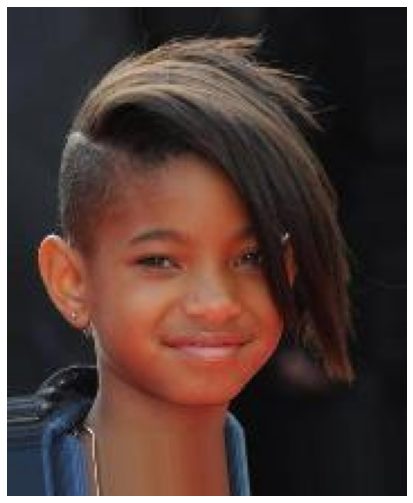

filename: Validation/Female/189163.jpg, male_proba: 0.7596526741981506


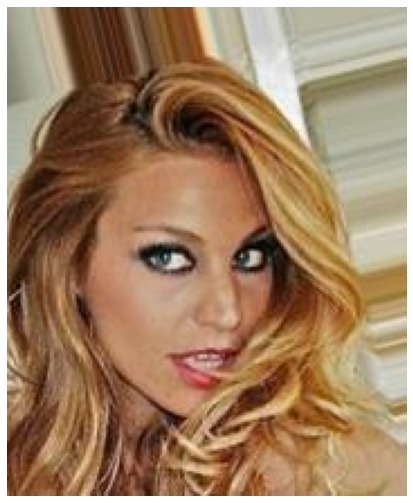

filename: Validation/Female/180438.jpg, male_proba: 0.8059828877449036


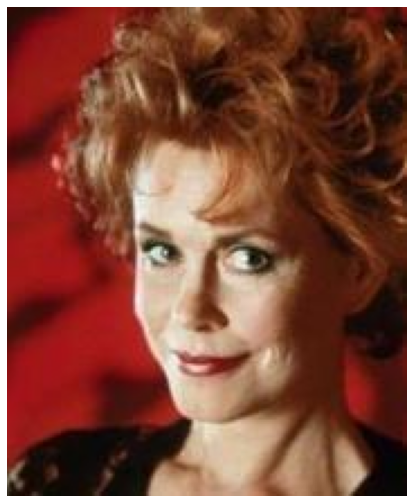

filename: Validation/Female/183546.jpg, male_proba: 0.4907207489013672


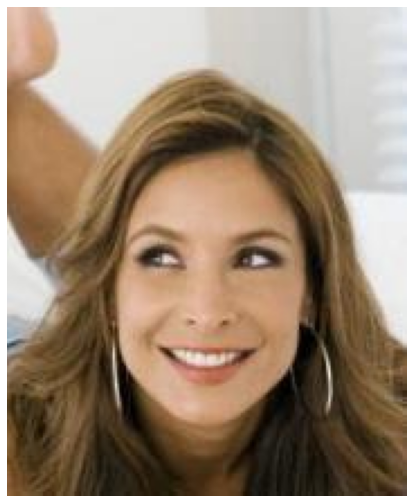

filename: Validation/Female/192625.jpg, male_proba: 0.9205965399742126


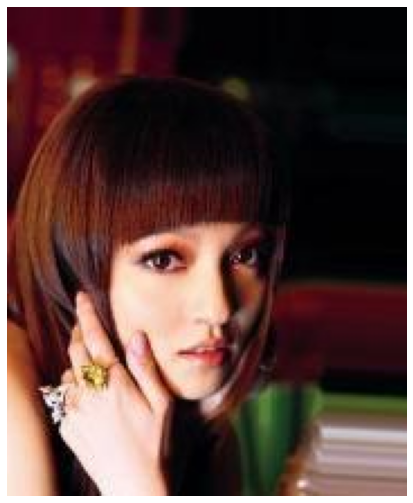

filename: Validation/Female/198597.jpg, male_proba: 0.4746280908584595


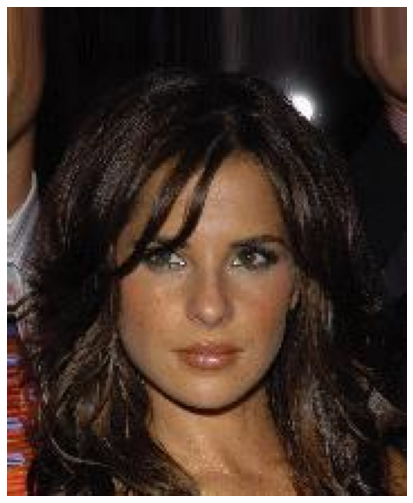

filename: Validation/Female/200491.jpg, male_proba: 0.2607339918613434


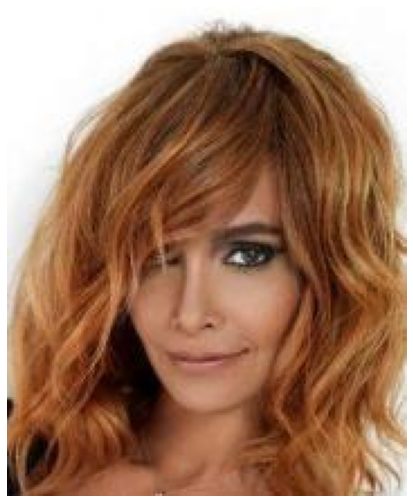

filename: Validation/Male/189719.jpg, male_proba: 0.9272271990776062


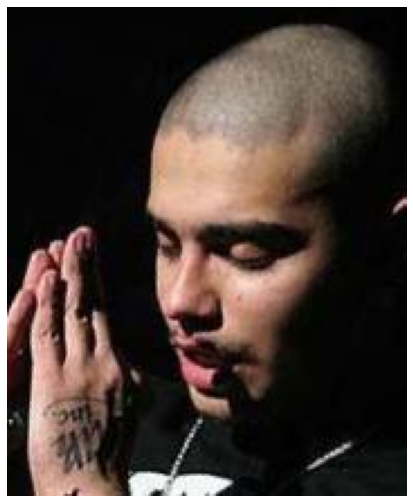

filename: Validation/Female/198003.jpg, male_proba: 0.1183692067861557


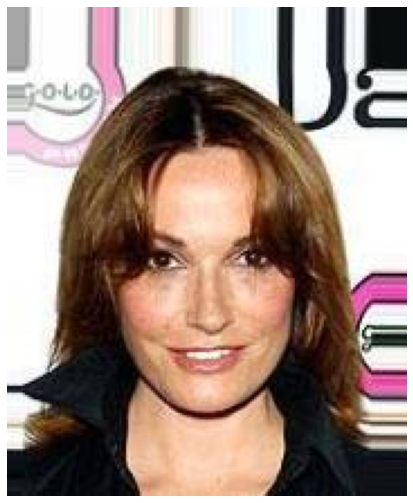

filename: Validation/Female/191251.jpg, male_proba: 0.47851571440696716


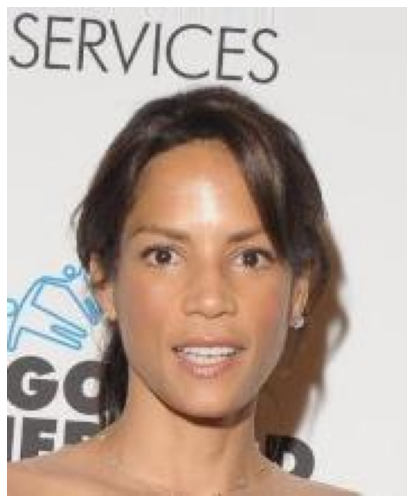

filename: Validation/Male/183973.jpg, male_proba: 0.35084739327430725


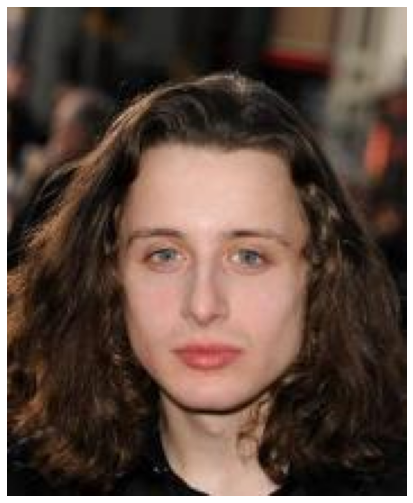

filename: Validation/Male/180401.jpg, male_proba: 0.9497970938682556


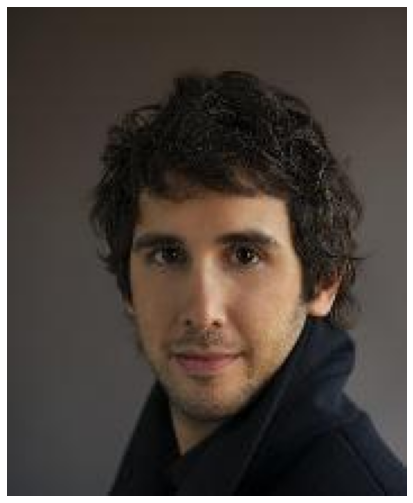

filename: Validation/Male/183114.jpg, male_proba: 0.5667262673377991


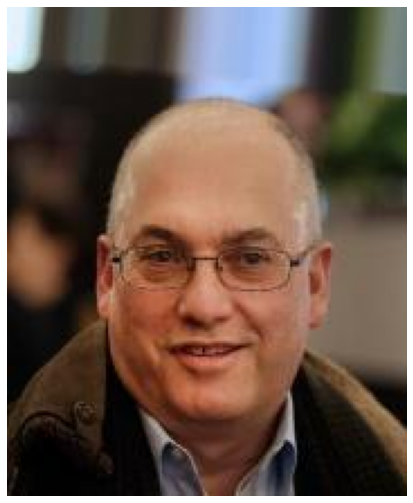

filename: Validation/Male/201477.jpg, male_proba: 0.8606693148612976


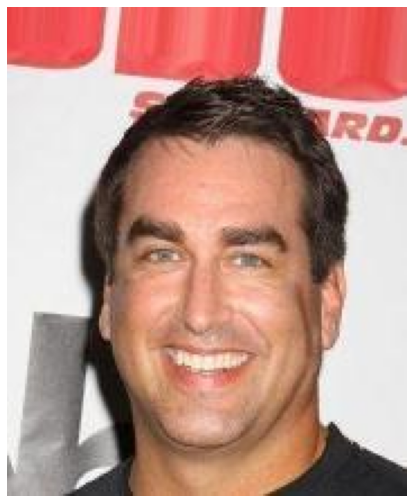

filename: Validation/Female/198205.jpg, male_proba: 0.5305479168891907


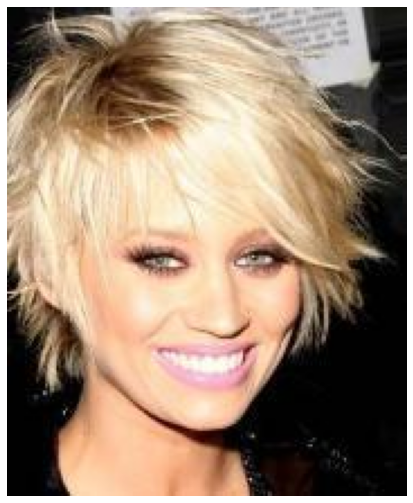

filename: Validation/Female/201400.jpg, male_proba: 0.9773420691490173


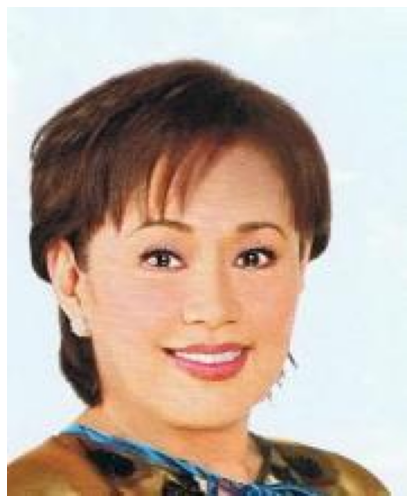

filename: Validation/Male/182685.jpg, male_proba: 0.33159399032592773


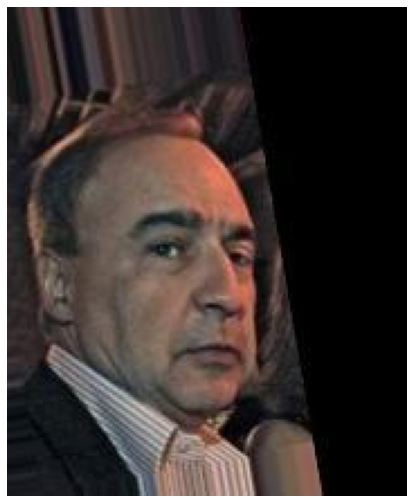

filename: Validation/Female/185732.jpg, male_proba: 0.9555568695068359


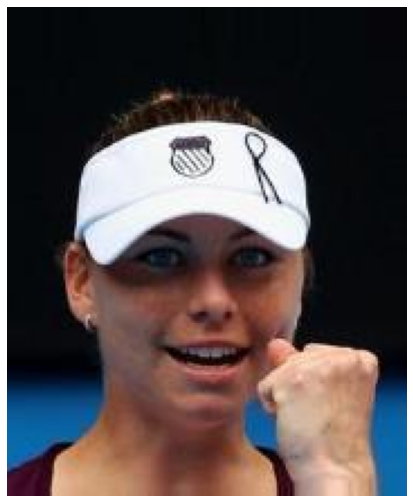

filename: Validation/Female/196547.jpg, male_proba: 0.8728026747703552


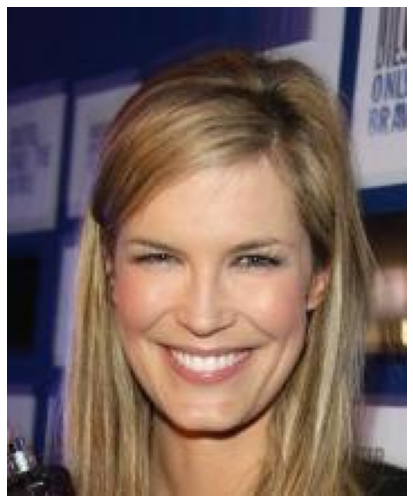

filename: Validation/Male/192037.jpg, male_proba: 0.853543221950531


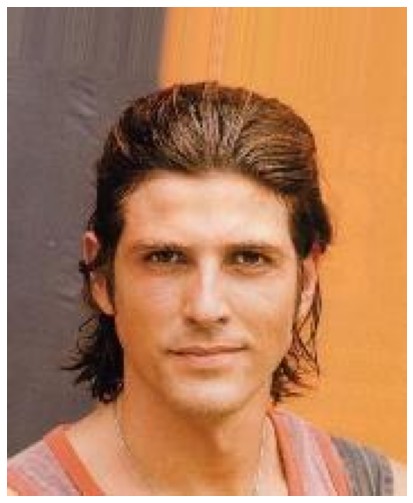

filename: Validation/Male/201436.jpg, male_proba: 0.7739805579185486


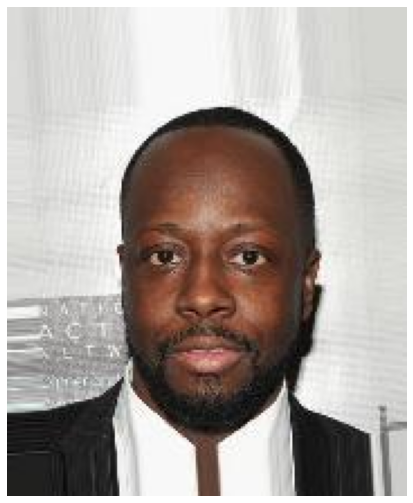

filename: Validation/Female/186008.jpg, male_proba: 0.7617499828338623


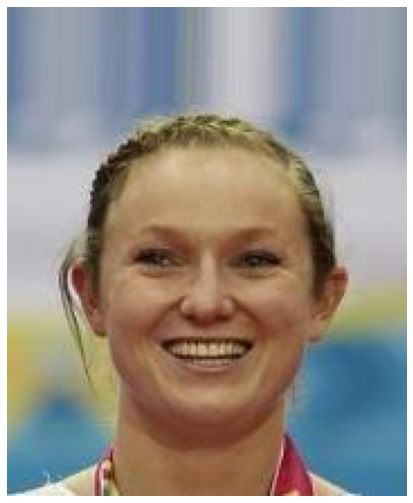

filename: Validation/Male/188577.jpg, male_proba: 0.5889996886253357


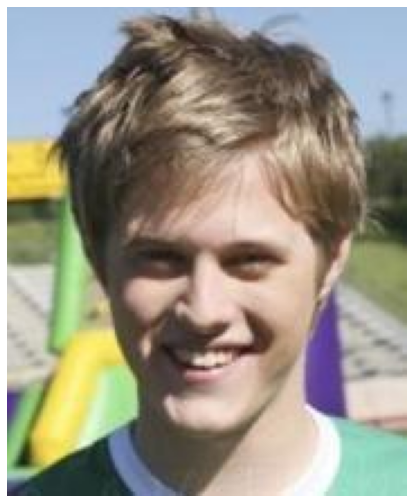

filename: Validation/Male/193456.jpg, male_proba: 0.7841606736183167


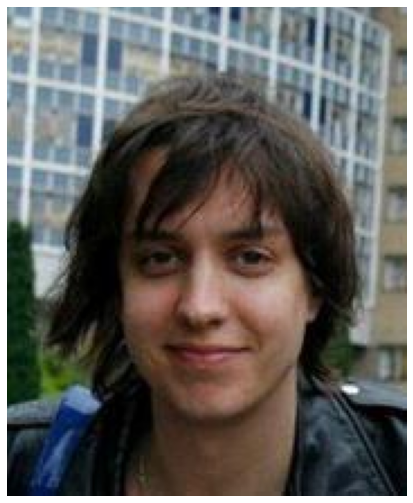

filename: Validation/Female/186771.jpg, male_proba: 0.8994213342666626


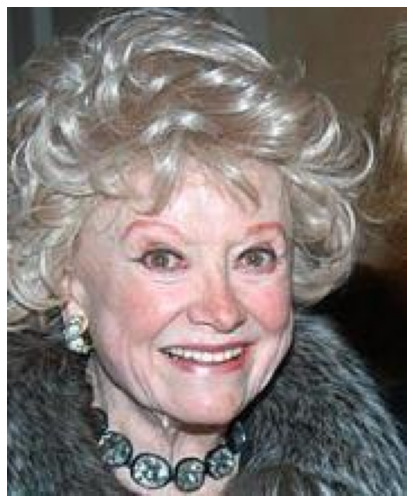

filename: Validation/Male/189447.jpg, male_proba: 0.9699847102165222


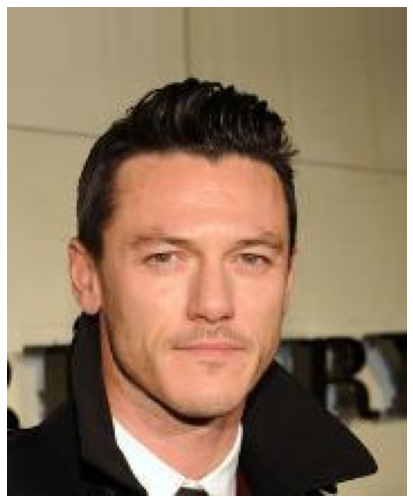

filename: Validation/Male/193285.jpg, male_proba: 0.8704875111579895


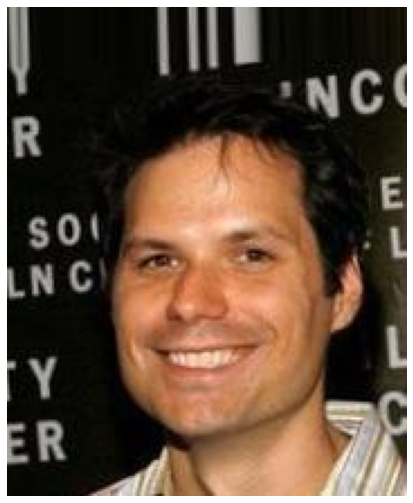

filename: Validation/Female/185250.jpg, male_proba: 0.5909891128540039


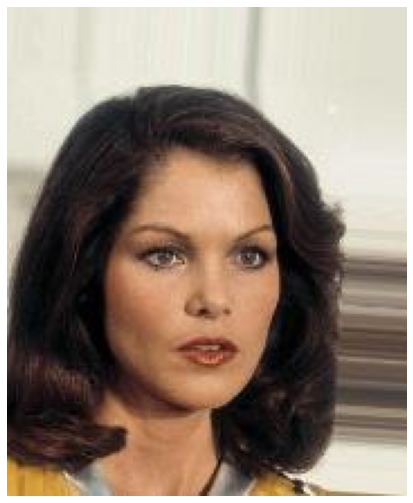

filename: Validation/Male/186971.jpg, male_proba: 0.9246011972427368


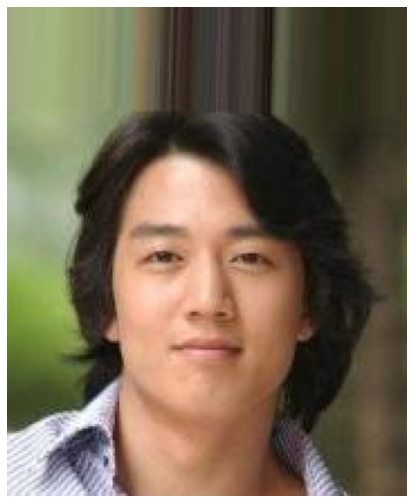

filename: Validation/Male/181675.jpg, male_proba: 0.9079640507698059


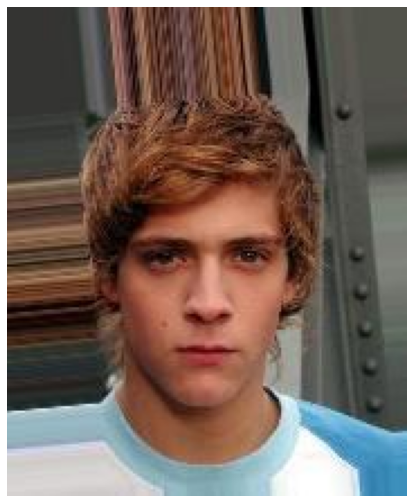

filename: Validation/Female/192390.jpg, male_proba: 0.9108638763427734


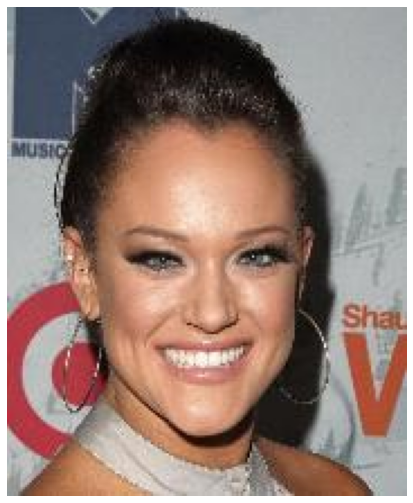

filename: Validation/Female/183247.jpg, male_proba: 0.779583752155304


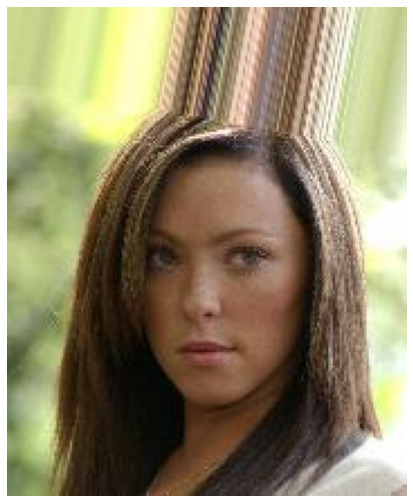

filename: Validation/Female/189292.jpg, male_proba: 0.8577601909637451


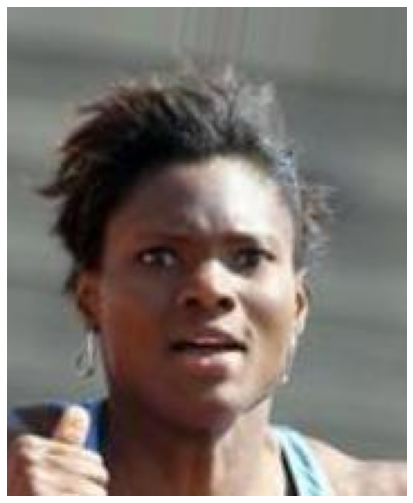

filename: Validation/Male/196316.jpg, male_proba: 0.64375901222229


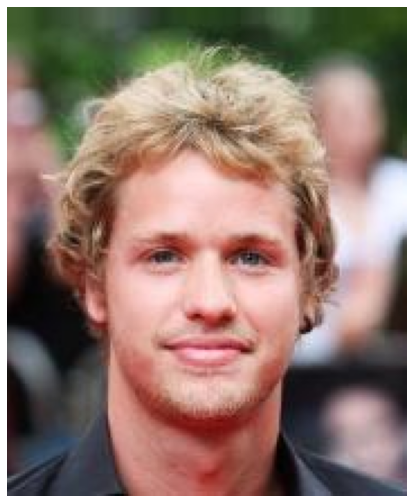

filename: Validation/Male/197381.jpg, male_proba: 0.8986722230911255


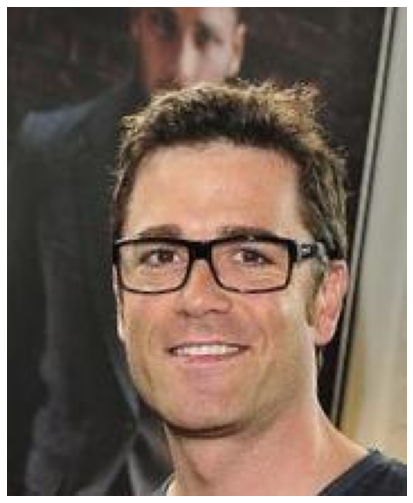

filename: Validation/Female/195480.jpg, male_proba: 0.30436646938323975


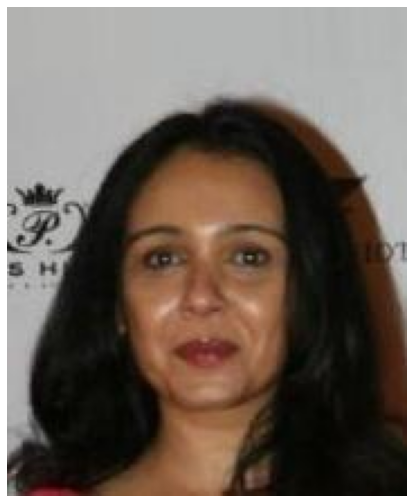

filename: Validation/Female/196589.jpg, male_proba: 0.9755660891532898


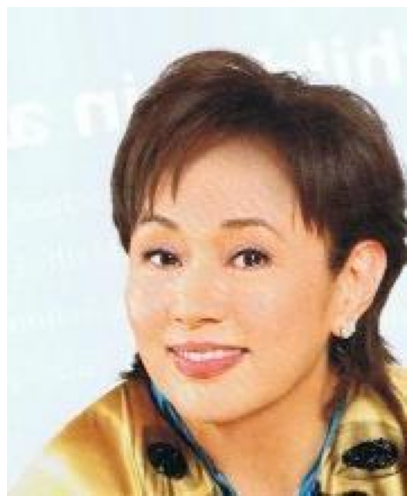

filename: Validation/Male/191765.jpg, male_proba: 0.9573196172714233


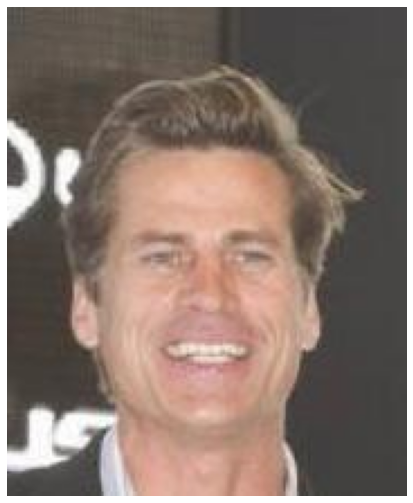

filename: Validation/Male/192302.jpg, male_proba: 0.9085841774940491


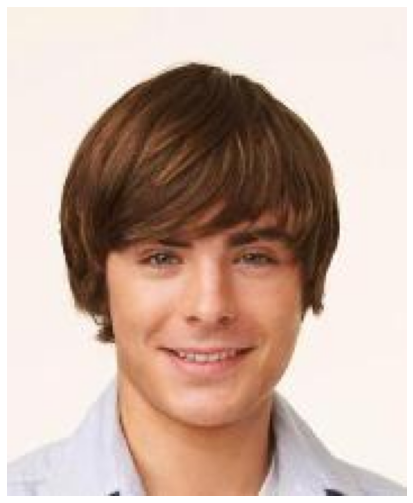

filename: Validation/Female/181165.jpg, male_proba: 0.7887001037597656


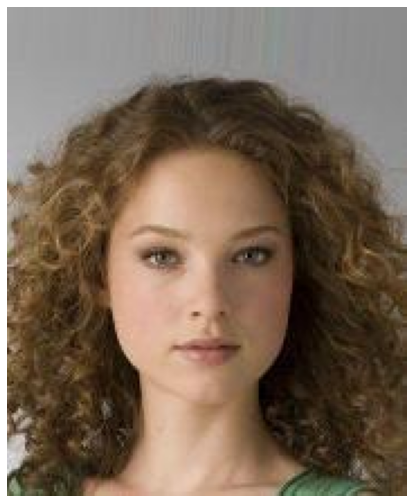

filename: Validation/Female/189673.jpg, male_proba: 0.7738738656044006


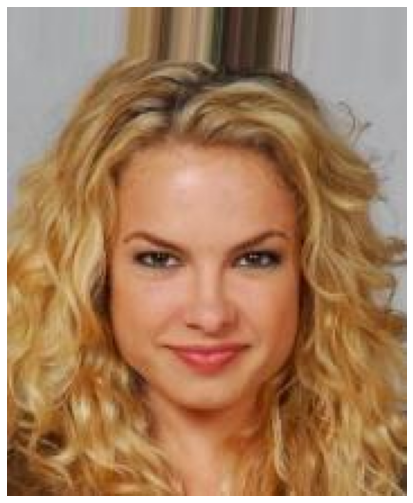

filename: Validation/Female/196609.jpg, male_proba: 0.6245214343070984


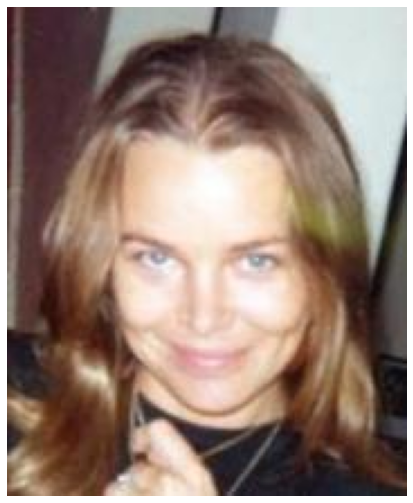

filename: Validation/Male/188808.jpg, male_proba: 0.9706135392189026


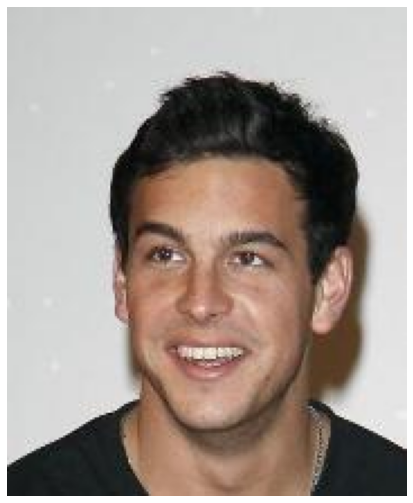

filename: Validation/Male/184154.jpg, male_proba: 0.7867909073829651


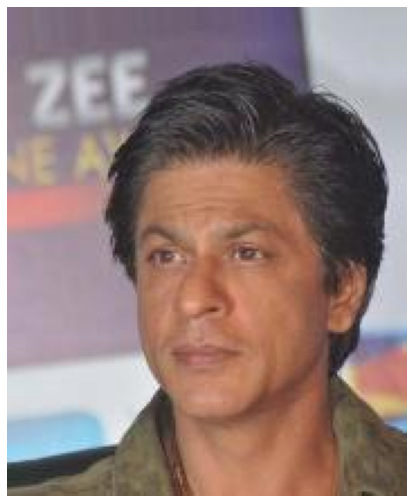

filename: Validation/Male/188836.jpg, male_proba: 0.9589582085609436


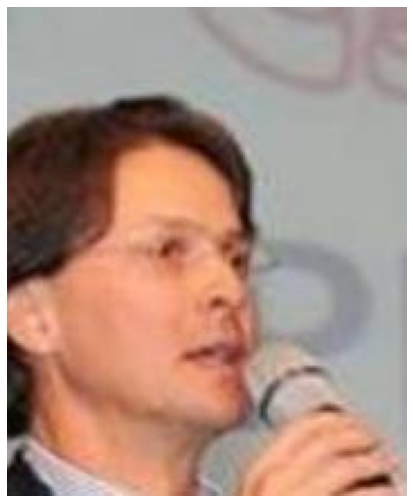

filename: Validation/Male/199522.jpg, male_proba: 0.8146170377731323


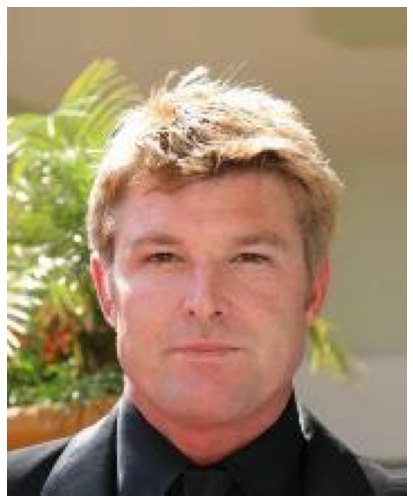

filename: Validation/Male/187504.jpg, male_proba: 0.9100800156593323


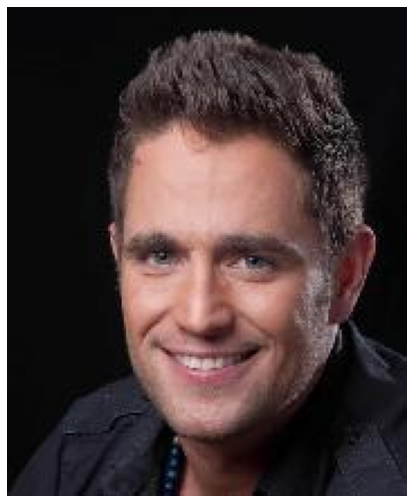

filename: Validation/Male/180435.jpg, male_proba: 0.677130401134491


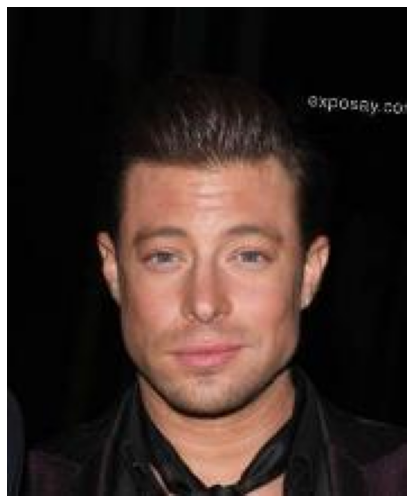

filename: Validation/Female/185978.jpg, male_proba: 0.978356659412384


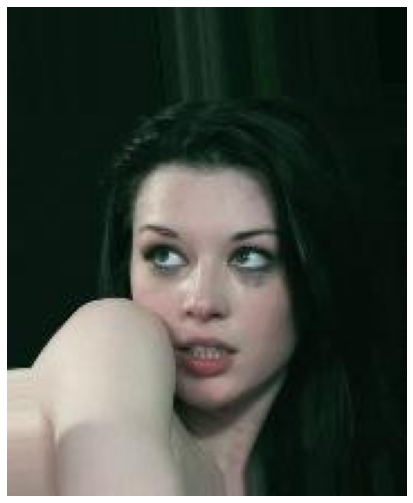

filename: Validation/Male/190945.jpg, male_proba: 0.799386203289032


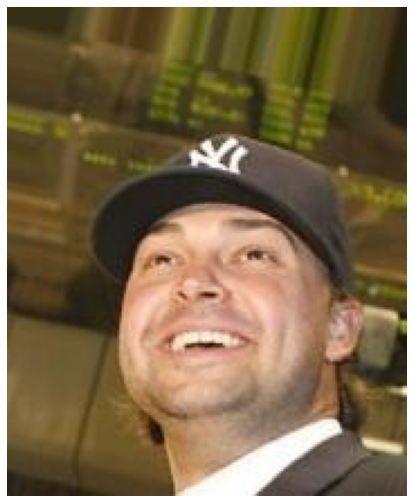

In [207]:
val_filenames = [pair[0] for pair in val_dataset.samples]
for file in np.random.choice(val_filenames, 50):
    male_proba = predict_male_proba(model_ft, file)
    print_file = "/".join(file.split("/")[-3:])
    print ("filename: {}, male_proba: {}".format(print_file, male_proba))
    show_image(cv2.imread(file))

# Посмотрим на ошибки

filename: Validation/Female/180048.jpg, male_proba: 0.799386203289032


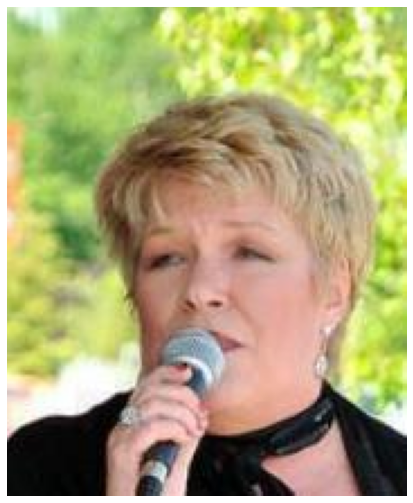

filename: Validation/Female/180115.jpg, male_proba: 0.799386203289032


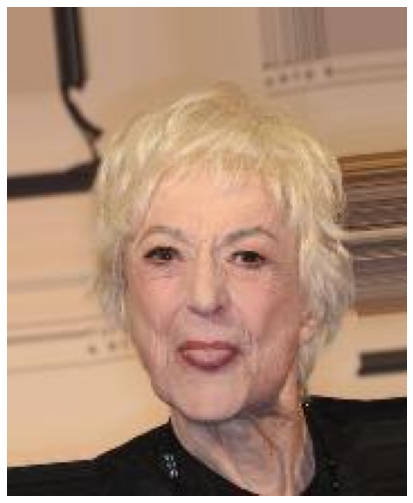

filename: Validation/Female/180133.jpg, male_proba: 0.799386203289032


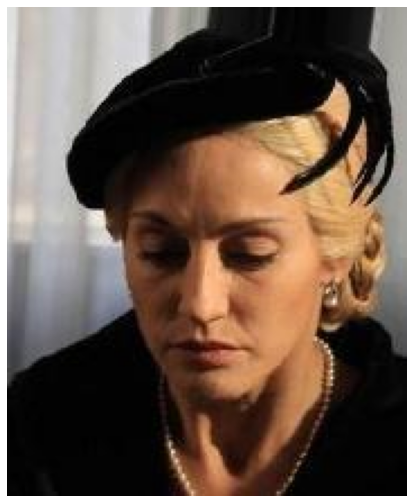

filename: Validation/Female/180173.jpg, male_proba: 0.799386203289032


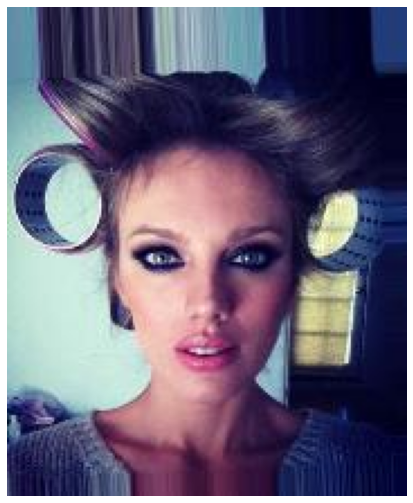

filename: Validation/Female/180176.jpg, male_proba: 0.799386203289032


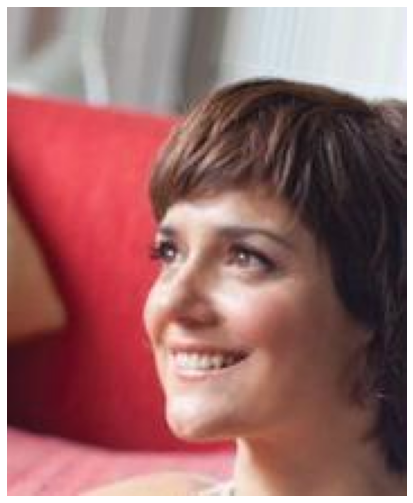

filename: Validation/Female/180177.jpg, male_proba: 0.799386203289032


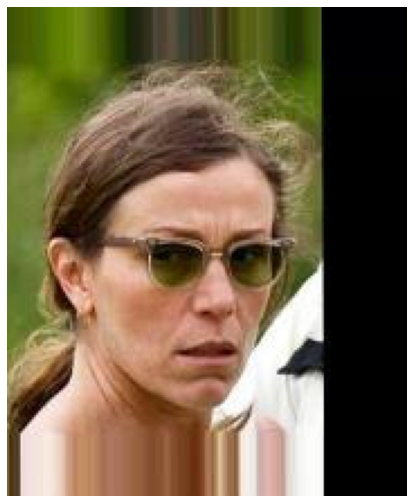

filename: Validation/Female/180229.jpg, male_proba: 0.799386203289032


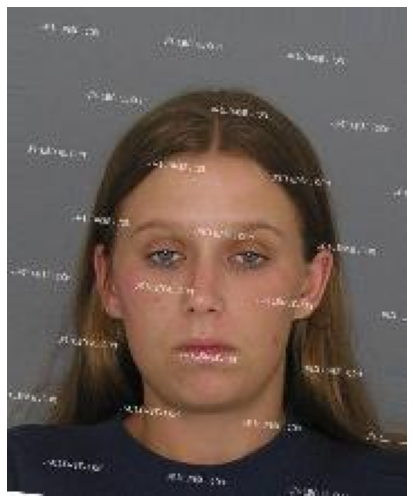

filename: Validation/Female/180232.jpg, male_proba: 0.799386203289032


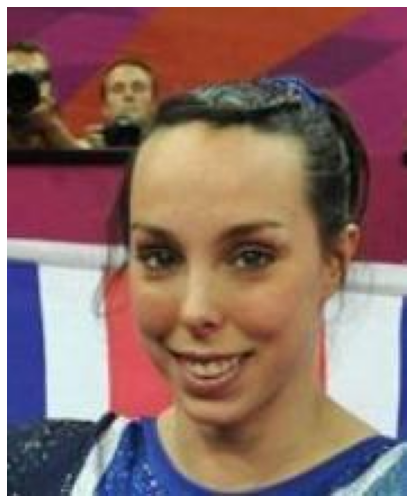

filename: Validation/Female/180236.jpg, male_proba: 0.799386203289032


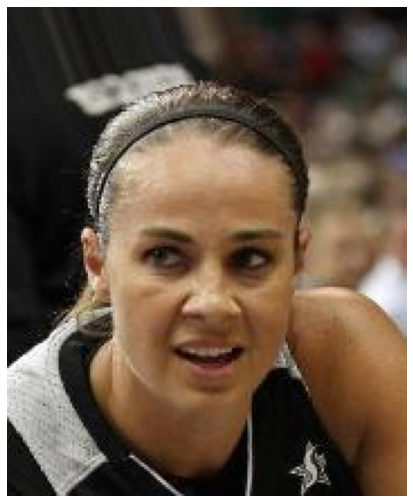

filename: Validation/Female/180239.jpg, male_proba: 0.799386203289032


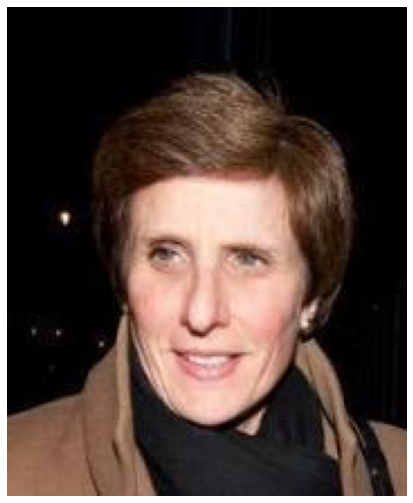

filename: Validation/Female/180249.jpg, male_proba: 0.799386203289032


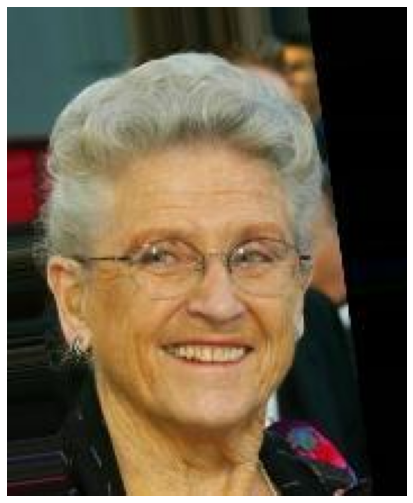

filename: Validation/Female/180261.jpg, male_proba: 0.799386203289032


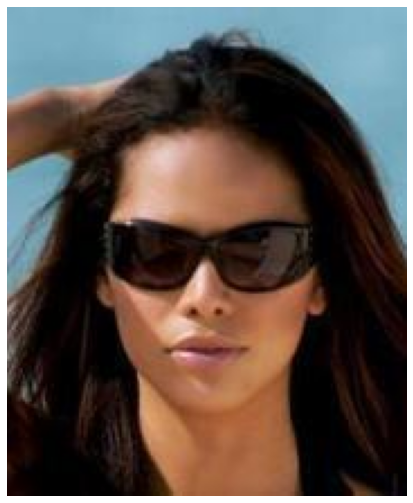

filename: Validation/Female/180315.jpg, male_proba: 0.799386203289032


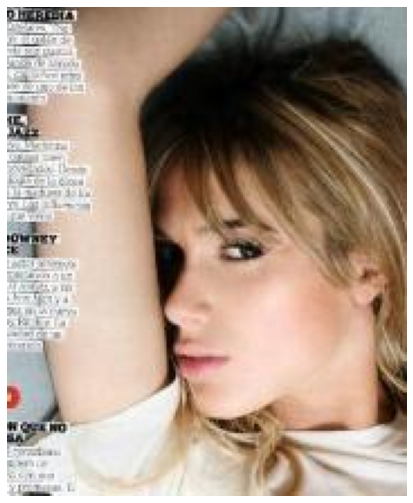

filename: Validation/Female/180318.jpg, male_proba: 0.799386203289032


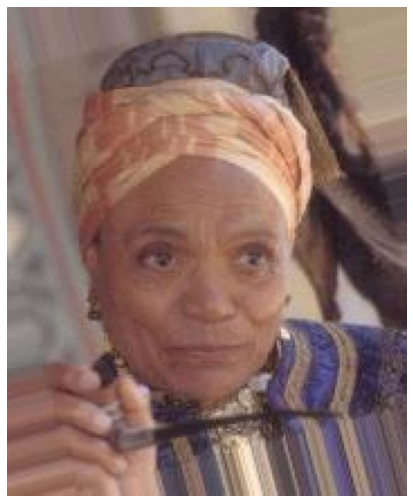

filename: Validation/Female/180347.jpg, male_proba: 0.799386203289032


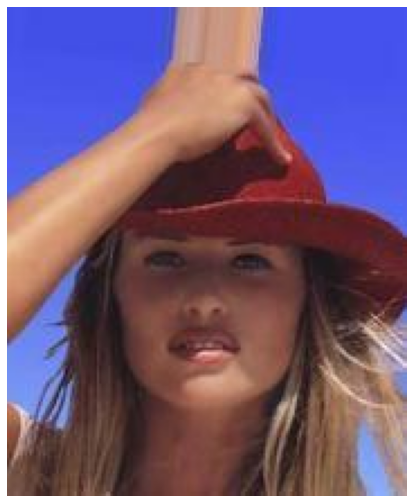

filename: Validation/Female/180383.jpg, male_proba: 0.799386203289032


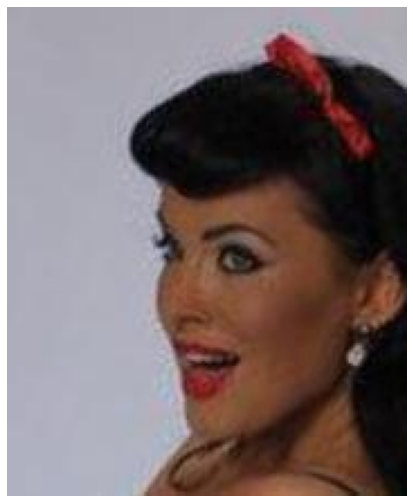

filename: Validation/Female/180412.jpg, male_proba: 0.799386203289032


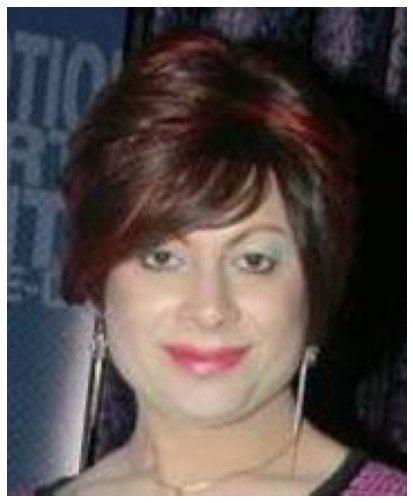

filename: Validation/Female/180470.jpg, male_proba: 0.799386203289032


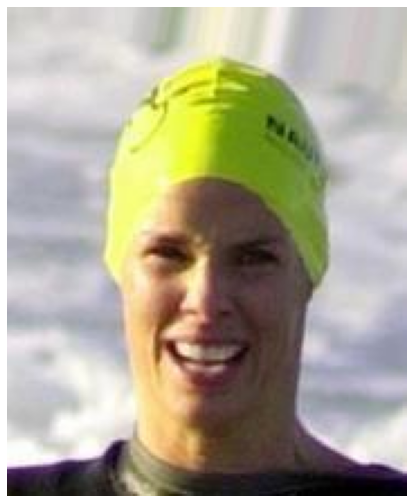

filename: Validation/Female/180503.jpg, male_proba: 0.799386203289032


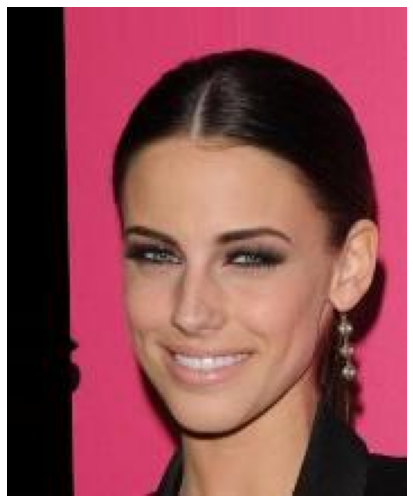

filename: Validation/Female/180526.jpg, male_proba: 0.799386203289032


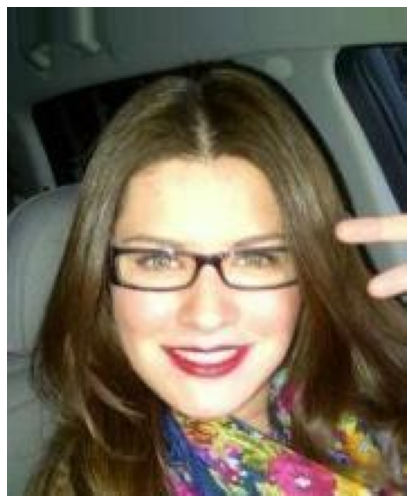

filename: Validation/Female/180588.jpg, male_proba: 0.799386203289032


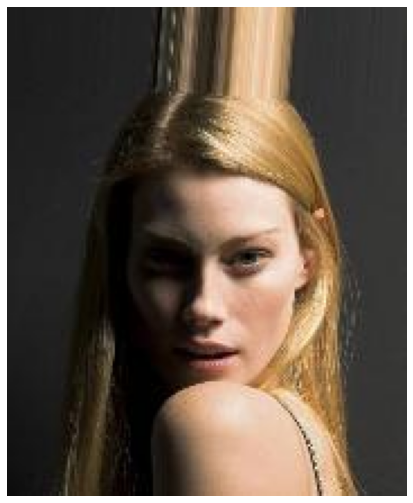

filename: Validation/Female/180695.jpg, male_proba: 0.799386203289032


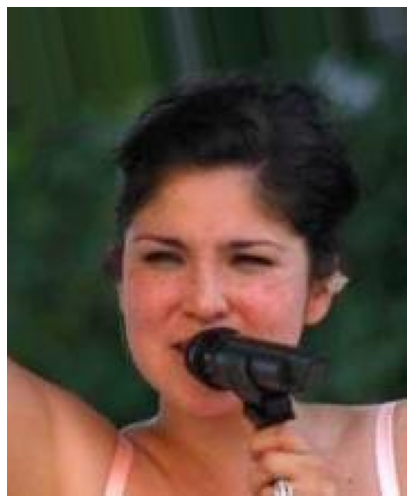

filename: Validation/Female/180703.jpg, male_proba: 0.799386203289032


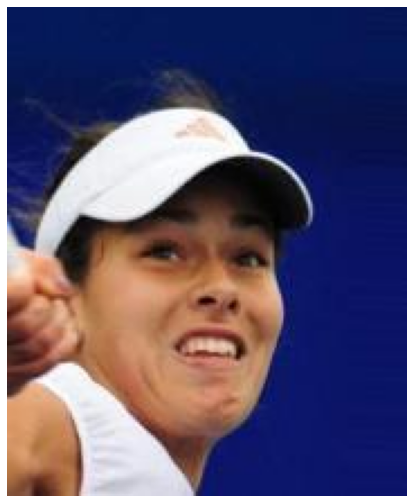

filename: Validation/Female/180718.jpg, male_proba: 0.799386203289032


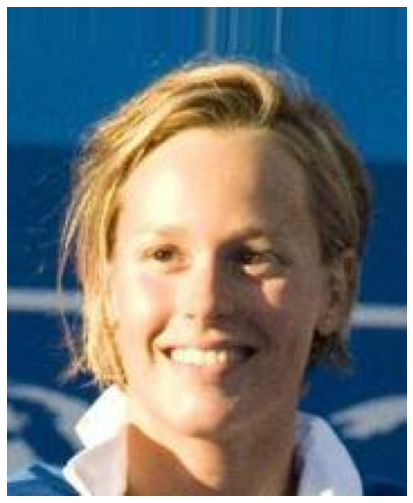

filename: Validation/Female/180726.jpg, male_proba: 0.799386203289032


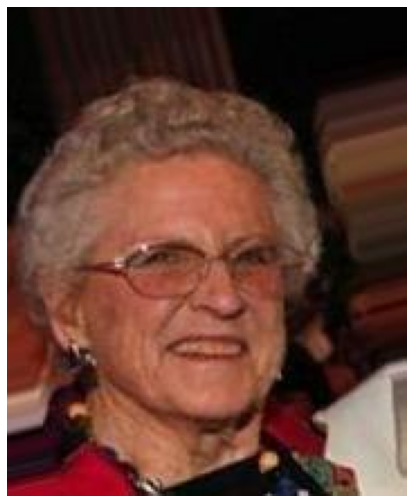

filename: Validation/Female/180756.jpg, male_proba: 0.799386203289032


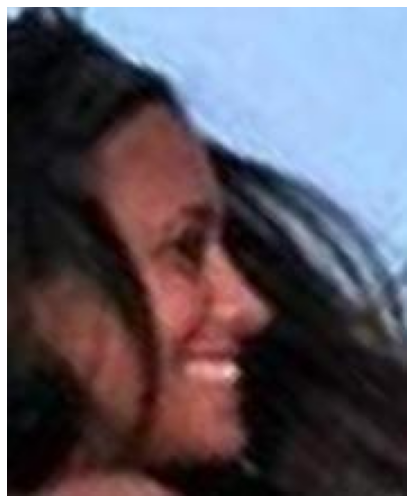

filename: Validation/Female/180771.jpg, male_proba: 0.799386203289032


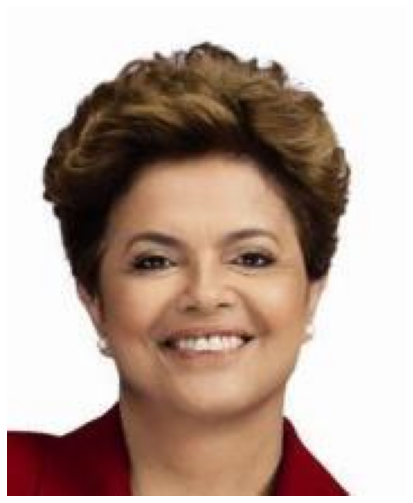

filename: Validation/Female/180780.jpg, male_proba: 0.799386203289032


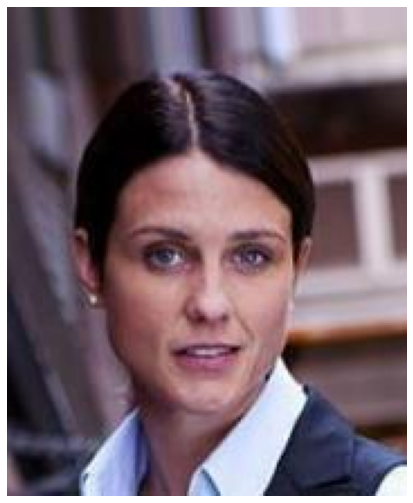

filename: Validation/Female/180785.jpg, male_proba: 0.799386203289032


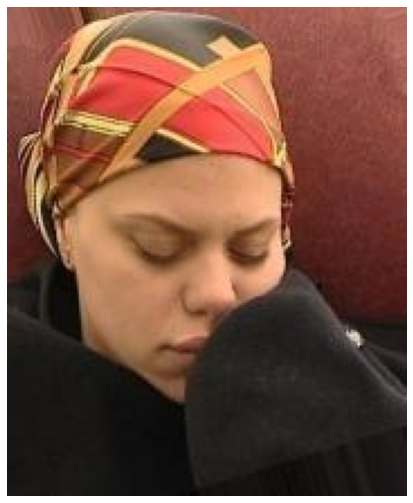

filename: Validation/Female/180798.jpg, male_proba: 0.799386203289032


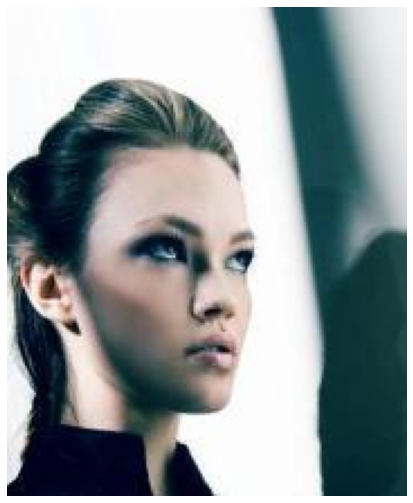

filename: Validation/Female/180834.jpg, male_proba: 0.799386203289032


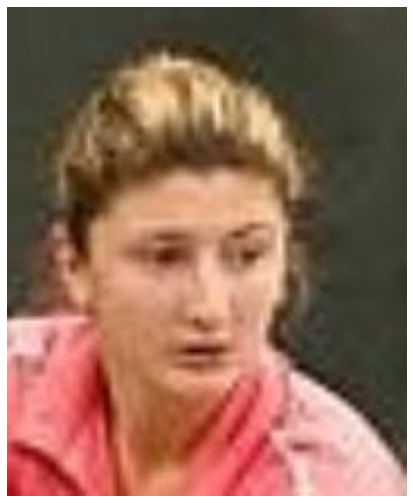

filename: Validation/Female/180845.jpg, male_proba: 0.799386203289032


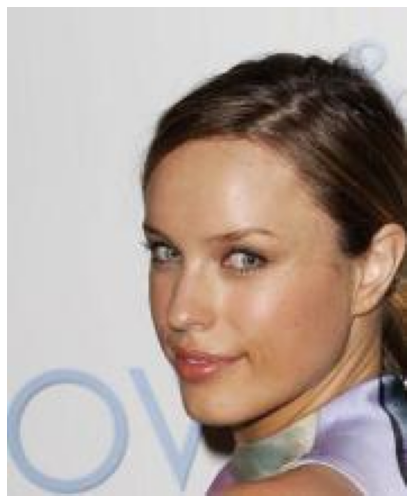

filename: Validation/Female/180876.jpg, male_proba: 0.799386203289032


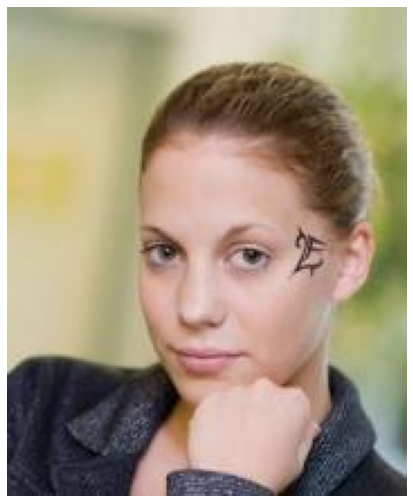

filename: Validation/Female/180880.jpg, male_proba: 0.799386203289032


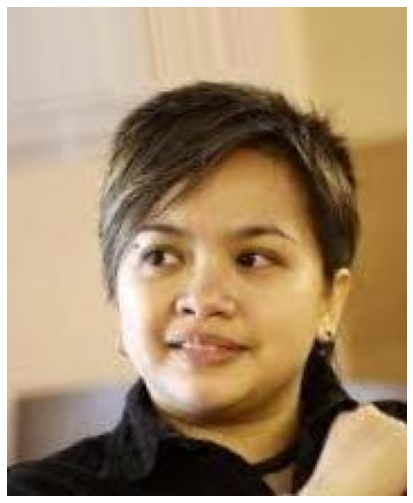

filename: Validation/Female/180949.jpg, male_proba: 0.799386203289032


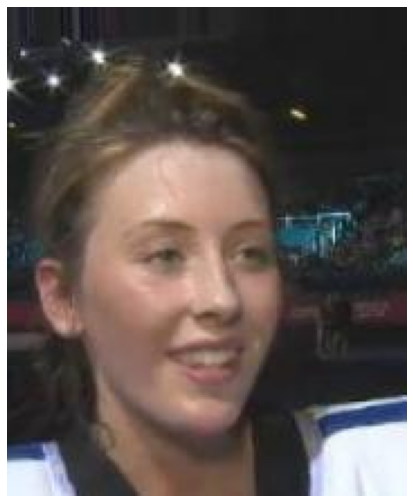

filename: Validation/Female/180973.jpg, male_proba: 0.799386203289032


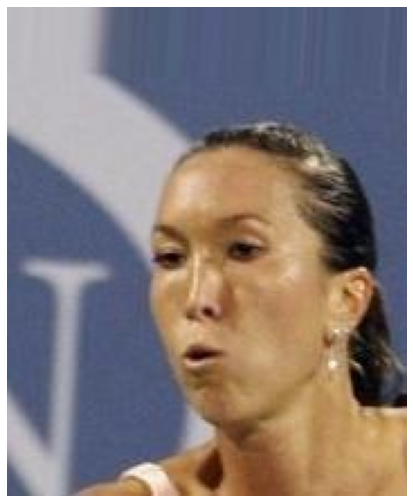

filename: Validation/Female/180984.jpg, male_proba: 0.799386203289032


KeyboardInterrupt: 

In [208]:
for file, label in checkpoint['gender_mistakes_filenames']:
    print_file = "/".join(file.split("/")[-3:])
    print ("filename: {}, male_proba: {}".format(print_file, male_proba))
    show_image(cv2.imread(file))